# Capstone: SG Food Recommender
Author: Choo Wende

---

## Part 3: Recommendation Systems

## Libraries Import

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import datetime as dt
import json
import requests
import random

from matplotlib import image
from bs4 import BeautifulSoup
from geopy.distance import geodesic
from collections import defaultdict

from surprise import Reader, Dataset, accuracy
from surprise.model_selection import cross_validate
from surprise.model_selection.search import GridSearchCV
from surprise.prediction_algorithms import NormalPredictor, BaselineOnly, SVD, NMF, \
KNNBasic, KNNWithMeans, KNNWithZScore, KNNBaseline

from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics.pairwise import cosine_similarity 

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
pd.options.mode.chained_assignment = None

## Import Data

In [2]:
# Read merged dataframe
df = pd.read_csv('../data/final_df.csv')
df.shape

C:\Users\Wende.Joanne\AppData\Local\Temp\ipykernel_18368\2596577802.py:2: DtypeWarning: Columns (3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('../data/final_df.csv')


(21790, 197)

In [3]:
# Display Dataframe info.
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21790 entries, 0 to 21789
Columns: 197 entries, rest_name to topic_keywords
dtypes: float64(5), int64(179), object(13)
memory usage: 32.8+ MB


In [4]:
# Display first 2 rows of merged dataframe
df.head(2)

,rest_name,href,address,postal_code,latitude,longitude,opening,img,star_rating,review_count,...,category_irish,category_barbeque,category_mediterranean,category_thai,category_greek,category_food_stands,local_user,word_count,dominant_topic,topic_keywords
0,The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapo...,39 Malan Rd Singapore 109442 Singapore,109442,1.276081,103.804434,"[('Mon', ['12:00 PM - 3:00 PM', '6:00 PM - 10:...",https://s3-media0.fl.yelpcdn.com/bphoto/ScSHvC...,4.5,19.0,...,0,0,0,0,0,0,1,34,2,"food, good, place, great, service, really, pri..."
1,The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapo...,39 Malan Rd Singapore 109442 Singapore,109442,1.276081,103.804434,"[('Mon', ['12:00 PM - 3:00 PM', '6:00 PM - 10:...",https://s3-media0.fl.yelpcdn.com/bphoto/ScSHvC...,4.5,19.0,...,0,0,0,0,0,0,1,31,4,"time, one, order, like, table, food, even, get..."


In [5]:
# Instantiate dataframe columns
rest_info_col = [
    'rest_name',
    'href',
    'address',
    'postal_code',
    'latitude',
    'longitude',
    'opening',
    'img',
    'star_rating',
    'review_count',
    'location',
    'price_range'
]

user_info_col = [
    'username',
    'userid',
    'user_location',
    'user_rating',
    'review_date',
    'comment', 
    'dominant_topic', 
    'topic_keywords',
    'word_count', 
    'local_user'
]

cat_col = df.drop(columns = rest_info_col + user_info_col).columns.tolist()

In [6]:
# Display datatype for non-cat_col
df[rest_info_col + user_info_col].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21790 entries, 0 to 21789
Data columns (total 22 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   rest_name       21790 non-null  object 
 1   href            21790 non-null  object 
 2   address         21790 non-null  object 
 3   postal_code     21790 non-null  object 
 4   latitude        21790 non-null  float64
 5   longitude       21790 non-null  float64
 6   opening         21790 non-null  object 
 7   img             21790 non-null  object 
 8   star_rating     21790 non-null  float64
 9   review_count    21790 non-null  float64
 10  location        21790 non-null  object 
 11  price_range     21790 non-null  float64
 12  username        21790 non-null  object 
 13  userid          21790 non-null  object 
 14  user_location   21790 non-null  object 
 15  user_rating     21790 non-null  int64  
 16  review_date     21790 non-null  object 
 17  comment         21790 non-null 

In [7]:
# Convert review_date to datetime
df['review_date'] = pd.to_datetime(df['review_date'])

## Map Overview of Restaurant Locations

In [8]:
# load image as pixel array
sg_map_data = image.imread('../data/sg_map_grayscale.png')

# summarize shape of the pixel array
print(sg_map_data.dtype)
print(sg_map_data.shape)

# Define longitude and latitude for sg_map
lon_lat_boundary = (103.6, 104.1, 1.2, 1.5)


float32
(803, 1342)


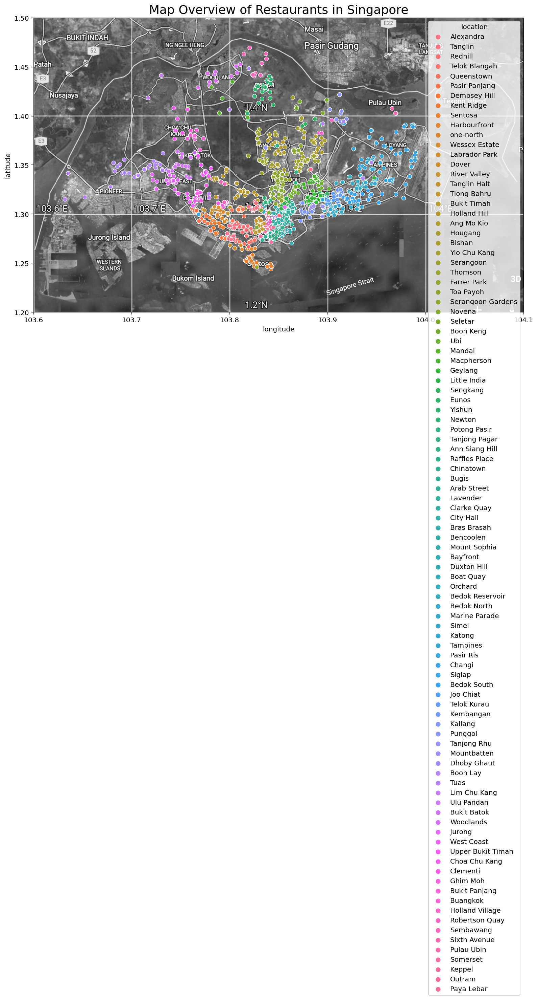

In [9]:
# Plot overview of restaurant locations
plt.figure(figsize=(15,8))
plt.title('Map Overview of Restaurants in Singapore', size=18)
plt.imshow(sg_map_data, 
           cmap=plt.get_cmap('Greys_r'), 
           extent=lon_lat_boundary);
sns.scatterplot(data=df, y='latitude', x='longitude', hue='location');

## Outline of Recommender

The SG Food Recommender aim to build a collaborative filtering recommendation system. The overall structure of the recommender is as follows:

1. **Stage 1: Location-based filtering**. For new users with 3 or less review submissions, it may be difficult to recommend restaurants based on their profile. To address this user cold start issue, the recommender will start of with a location-based filtering. The filter is built using `Kmeansmodel` to identify optimal restaurant clusters and filter top 10 restaurants purely based on rating within the user's location.   


2. **Stage 2: Collaborative Filtering.**  

    - **Stage 2a: Memory Based Filtering.** Stage 2a filters restaurants based on user and restaurant similarity and add more restaurants to the set of restaurants filtered from the locations. Restaurants that were visited by the user are removed from this set of restaurants.
        - **User-based Collaborative Filtering.** This stage filters restaurants based on the interests of a user by comparing the restaurants ratings from other users. It is assumed that users have similar ratings on a set of restaurants, they are likely to rate similarly on unknown restaurants. A user-restaurant matrix was created based on ratings and cosine similarity was computed using the matrix. Restaurants visited by the similar users are consolidated and add on to the set of restaurants for the user.  
        - **Item-based Collaborative Filtering.** This filter uses data on the reviews and restaurants visited by the user and generate a set of similar restaurants. This is done through formulating a restaurants by their features matrix and compute the cosine similarity. This filtered set of restaurants are then added to the set of existing restaurants.
        
    - **Stage 2b: Model Based.** Using the consolidated set of restaurants filtered earlier, the model predicts the ratings of the restaurants not visited by the user and recommends the highest rated restaurants within a distance set by the user. 

## 7a.  Location-based Filtering

The restaurants are grouped in to optimal number of clusters based on geographical location through the use of the K-Means Clustering Model. Then, based on the user's location and restaurants cluster that he/she is in, the K-Means Model generate the top 10 restaurants based on ratings for the user.

In [10]:
# Create Dataframe of restaurants and their latitude & longitude.
rest_coord_df = df[['rest_name', 'href', 'longitude','latitude']]
rest_coord_df.drop_duplicates(subset = 'href', ignore_index=True, inplace=True)
rest_coord_df.head()

,rest_name,href,longitude,latitude
0,The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapo...,103.804434,1.276081
1,Soi Thai Soi Nice,http://www.yelp.com/biz/soi-thai-soi-nice-sing...,103.805283,1.287283
2,The Gogi,http://www.yelp.com/biz/the-gogi-singapore?osq...,103.805283,1.287283
3,Keng Eng Kee Seafood,http://www.yelp.com/biz/keng-eng-kee-seafood-s...,103.803532,1.285823
4,Burger Barn,http://www.yelp.com/biz/burger-barn-singapore?...,103.801399,1.274149


In [11]:
# Print shape of dataframe
rest_coord_df.shape

(3938, 4)

In [12]:
# Create a list to store the silhouette score and inertia of the models
scores = []

# Search through a range of k values. 
for k in range(2,15):
    kmeansModel = KMeans(n_clusters=k, random_state=42)
    kmeansModel = kmeansModel.fit(rest_coord_df[['longitude','latitude']])
    sil = silhouette_score(rest_coord_df[['longitude','latitude']], kmeansModel.labels_)
    scores.append([k, kmeansModel.inertia_, sil])

# Show the scores from the search. 
score_df = pd.DataFrame(scores, 
                        columns=['k', 'inertia', 'silhouette'])
score_df

,k,inertia,silhouette
0,2,9.573294,0.466138
1,3,6.002034,0.502187
2,4,4.012949,0.538148
3,5,3.209075,0.483516
4,6,2.532166,0.490060
5,7,1.923312,0.530030
6,8,1.636882,0.441364
7,9,1.423097,0.445799
8,10,1.291612,0.443821
9,11,1.169137,0.444427


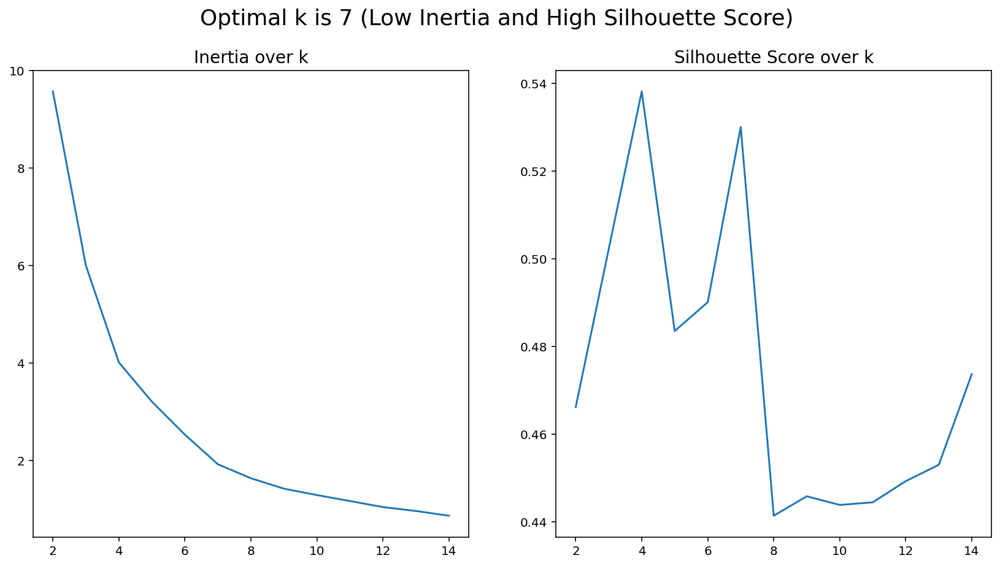

In [13]:
# Graph for WSS
fig, axes = plt.subplots(1, 2, figsize=(14, 7))
plt.suptitle('Optimal k is 7 (Low Inertia and High Silhouette Score)', size=18)
axes[0].plot(score_df.k, score_df.inertia)
axes[0].set_title('Inertia over k', size=14)
axes[1].plot(score_df.k, score_df.silhouette)
axes[1].set_title('Silhouette Score over k', size=14);

1. Inertia measures how well a dataset was clustered by K-Means. It is calculated by measuring the distance between each data point and its centroid, squaring this distance, and summing these squares across one cluster. A good model is one with low inertia AND a low number of clusters ( K ) ([source](https://www.codecademy.com/learn/machine-learning/modules/dspath-clustering/cheatsheet)). For different values of k, the respective inertia is computed. 
2. Silhouette score is used to evaluate the quality of clusters created in terms of how well samples are clustered with other samples that are similar to each other. The Silhouette score is calculated for each sample of different clusters. A good model is one with high silhouette score.  
3. Starting from 2 clusters, the optimal k, having low inertia and high inertia, is assessed to be k = 7 (clusters).

In [14]:
# Instantiate and fit kmeansModel
kmeansModel = KMeans(n_clusters=7)
kmeansModel.fit(rest_coord_df[['longitude','latitude']])

print("k = 7")
print("inertia: ", kmeansModel.inertia_)
print("silhouette_score: ", silhouette_score(rest_coord_df[['longitude','latitude']], kmeansModel.labels_))

k = 7
inertia:  1.9233124648605862
silhouette_score:  0.5300302400544131


In [15]:
# Create new column called rest_clusters
df['rest_cluster'] = kmeansModel.predict(df[['longitude','latitude']])

# Verify reset_cluster column. 
df[['rest_name','rest_cluster']].drop_duplicates()

,rest_name,rest_cluster
0,The Naked Finn,4
19,Soi Thai Soi Nice,4
21,The Gogi,4
22,Keng Eng Kee Seafood,4
44,Burger Barn,4
...,...,...
21783,Al Malik,5
21784,Yureka Teppanyaki Restaurant,5
21785,Wadori Yakitori,5
21786,Thai Hao Chi Mookata,5


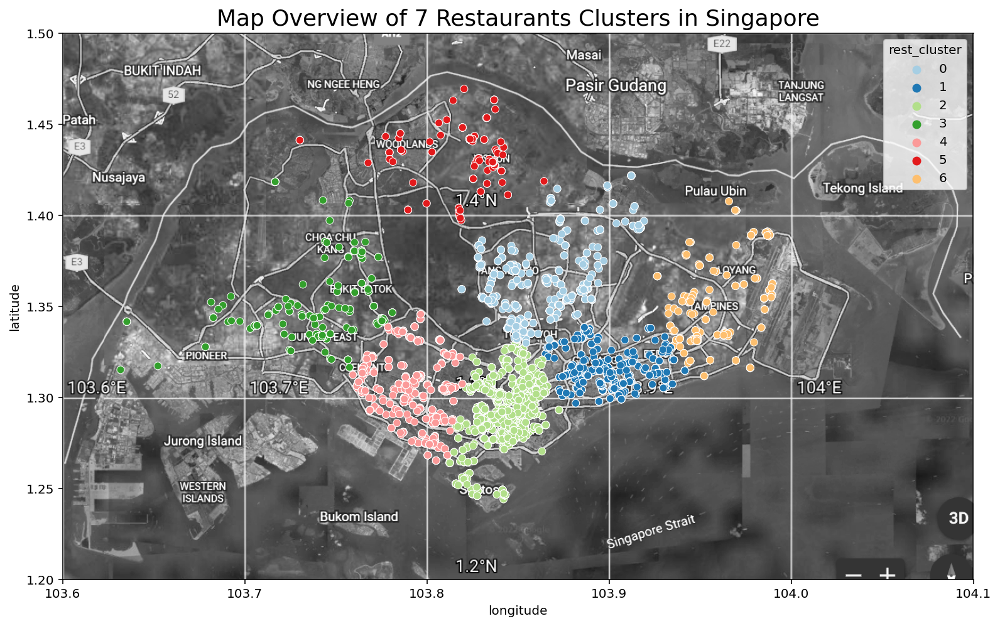

In [16]:
# Geographical Plot of 7 Clusters
plt.figure(figsize=(15,8))
plt.title('Map Overview of 7 Restaurants Clusters in Singapore', size=18)
plt.imshow(sg_map_data, 
           cmap=plt.get_cmap('Greys_r'), 
           extent=lon_lat_boundary);
sns.scatterplot(data=df, y='latitude', x='longitude', hue='rest_cluster', palette='Paired');

Singapore has an area of 729km², the 7 restaurant clusters identified are assessed to be optimal for the Location-Based Recommender, which to recommend restaurants within close vicinity to the user's geographical location.

The next step is to recommend restaurants with high ratings, which is likely to enhance user's experience of using the recommender. 

In [17]:
# Define function to scrape data from url.
def get_soup(url):
    
    # Establishing the connection to the web page:
    res = requests.get(url, stream=True)

    if res.status_code==200:
        return BeautifulSoup(res.content, 'lxml')
        
    else:
        print(f'Res Status Code: {res.status_code}')
        pass

In [18]:
# Define function which recommends top 10 highest rating restaurants
def location_based_recommender(df, postal_code):

    # get latitude and longitude based on postal_code
    onemap = get_soup(f'https://developers.onemap.sg/commonapi/search?searchVal={postal_code}&returnGeom=Y&getAddrDetails=Y&pageNum=1')
    address = json.loads(onemap.p.text)['results'][0]['ADDRESS']
    latitude = round(float(json.loads(onemap.p.text)['results'][0]['LATITUDE']),2)
    longitude = round(float(json.loads(onemap.p.text)['results'][0]['LONGTITUDE']),2)
    loc = pd.DataFrame({'longitude':[longitude],'latitude':[latitude]})
    
    # Predict restaurant cluster which the user is in.
    cluster = kmeansModel.predict(loc)[0]
    print(f"User's location: {address} ({longitude}, {latitude})")
    print("User is in restaurant cluster:", cluster)
   
    # Create dataframe for top 10 highest rated restaurant in this cluster
    top_10_rest_df = df[(df['rest_cluster']==cluster) & (df['review_count']>1)][rest_info_col+['rest_cluster']]
    top_10_rest_df = top_10_rest_df.drop_duplicates(ignore_index=True)
    top_10_rest_df = top_10_rest_df.sort_values(by=['star_rating', 'review_count'], ascending=False).reset_index(drop=True)  
    
    return top_10_rest_df.head(10)[['rest_name','href']], top_10_rest_df, loc

In [19]:
# define function to show restaurant clusters
def plot_rest_cluster(df, loc):
    plt.figure(figsize=(15,8))
    plt.title('Map Overview of 7 Restaurants Clusters in Singapore', size=18)
    plt.imshow(sg_map_data, 
               cmap=plt.get_cmap('Greys_r'), 
               extent=lon_lat_boundary);
    sns.scatterplot(data=df, y='latitude', x='longitude', marker='o', label='restaurants')
    sns.scatterplot(data=loc, y='latitude', x='longitude', marker='o', label='user')
    plt.legend();

### Examples

**Example 1**: Postal Code is '079906'.

In [20]:
results, top_10_rest_df, loc = location_based_recommender(df, '079906')
results

User's location: 79 ANSON ROAD SINGAPORE 079906 (103.85, 1.27)
User is in restaurant cluster: 2


,rest_name,href
0,Two Men Bagel House,http://www.yelp.com/biz/two-men-bagel-house-si...
1,Man Man Japanese Unagi,http://www.yelp.com/biz/man-man-japanese-unagi...
2,Ki-sho,http://www.yelp.com/biz/ki-sho-singapore?osq=R...
3,Rhubarb Le Restaurant,http://www.yelp.com/biz/rhubarb-le-restaurant-...
4,Hong Kong Style Chee Cheong Fun,http://www.yelp.com/biz/hong-kong-style-chee-c...
5,Meat And Green,http://www.yelp.com/biz/meat-and-green-singapo...
6,Tandoori Culture,http://www.yelp.com/biz/tandoori-culture-singa...
7,Neko no Niwa,http://www.yelp.com/biz/neko-no-niwa-singapore...
8,Sanji Kagoshima Ramen,http://www.yelp.com/biz/sanji-kagoshima-ramen-...
9,Akira Back,http://www.yelp.com/biz/akira-back-blackburn?o...


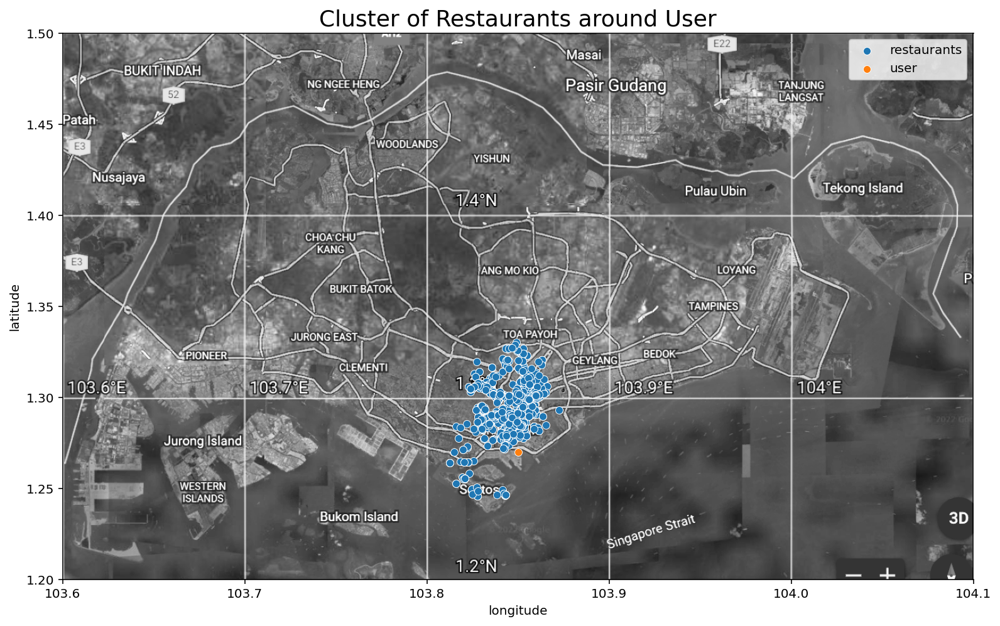

In [21]:
# Show map
plot_rest_cluster(top_10_rest_df, loc)
plt.gca().set_title('Cluster of Restaurants around User', size=18);

**Example 2**: Postal Code is '609081'.

In [22]:
results, top_10_rest_df, loc = location_based_recommender(df, '609081')
results

User's location: 15 SCIENCE CENTRE ROAD DBS SINGAPORE SCIENCE CENTRE SINGAPORE 609081 (103.74, 1.33)
User is in restaurant cluster: 3


,rest_name,href
0,Din Tai Fung,http://www.yelp.com/biz/din-tai-fung-singapore...
1,Shokutsu 10-Osaka,http://www.yelp.com/biz/shokutsu-10-osaka-sing...
2,Kotoshi Ryori Japanese Dining,http://www.yelp.com/biz/kotoshi-ryori-japanese...
3,iO Italian Osteria,http://www.yelp.com/biz/io-italian-osteria-sin...
4,Acqua e Farina,http://www.yelp.com/biz/acqua-e-farina-singapo...
5,Malaysia Boleh!,http://www.yelp.com/biz/malaysia-boleh-singapo...
6,Enaq Restaurant,http://www.yelp.com/biz/enaq-restaurant-singap...
7,Tsukada Nojo,http://www.yelp.com/biz/tsukada-nojo-singapore...
8,Fei Fei Roasted Noodles,http://www.yelp.com/biz/fei-fei-roasted-noodle...
9,Hai Di Lao,http://www.yelp.com/biz/hai-di-lao-singapore-2...


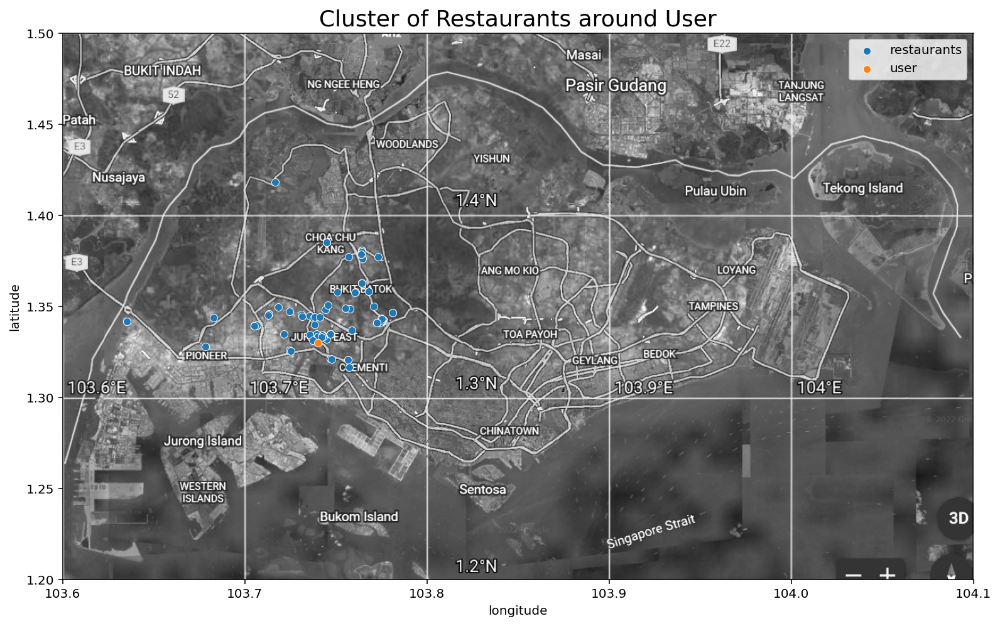

In [23]:
# Show map
plot_rest_cluster(top_10_rest_df, loc)
plt.gca().set_title('Cluster of Restaurants around User', size=18);

## 7b. Collaborative-Filtering

### (1) Memory based Filtering

#### User-based Collaborative Filtering

Collaborative filtering pulls out restaurants that a user might like on the based on ratings of similar users.

This is done through searching the user base and shortlisting a smaller set of users with similar preferences. It filters the restaurants they like and consolidates them into a set of recommended restaurants.

**User-Item Matrix**

In [24]:
# Create a dataframe of review counts based on users. 
user_base_df = df.groupby(['username', 'userid']).count()[['comment']].sort_values(by='comment', ascending=False)


In [25]:
# For modelling to be meaningful, database based on users with more than 4 comments will be used (refer to EDA). 
user_base_df = user_base_df[user_base_df['comment']>3].reset_index(drop=False)

In [26]:
# There are 1029 unique users with more than 3 reviews. 
# there are a total of 14,236 reviews.  
user_base_df.shape[0], user_base_df.sum()

(1029,
 username    Doreen T.Ancy N.Melissa Y.Lam N.Carolyn L.Jess...
 userid      2F38Uc4UNNbFVdyUUnBjOA4y4obgWxi_CL25nRHrhuEAH8...
 comment                                                 14236
 dtype: object)

In [27]:
# Display dataframe
user_base_df.head(3)

,username,userid,comment
0,Doreen T.,2F38Uc4UNNbFVdyUUnBjOA,290
1,Ancy N.,4y4obgWxi_CL25nRHrhuEA,173
2,Melissa Y.,H8mXfh5XgGCqmMLwVH7k5A,145


In [28]:
# extract reveiw index for these users. 
review_index = [] 
for userid in user_base_df['userid']:
    review_index.extend(df[df['userid']==userid].index)

In [29]:
df.loc[review_index, :].head(2)

,rest_name,href,address,postal_code,latitude,longitude,opening,img,star_rating,review_count,...,category_barbeque,category_mediterranean,category_thai,category_greek,category_food_stands,local_user,word_count,dominant_topic,topic_keywords,rest_cluster
1,The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapo...,39 Malan Rd Singapore 109442 Singapore,109442,1.276081,103.804434,"[('Mon', ['12:00 PM - 3:00 PM', '6:00 PM - 10:...",https://s3-media0.fl.yelpcdn.com/bphoto/ScSHvC...,4.5,19.0,...,0,0,0,0,0,1,31,4,"time, one, order, like, table, food, even, get...",4
67,Masons,http://www.yelp.com/biz/masons-singapore?osq=R...,8 Lock Road #01-17 Singapore 108936 Singapore,108936,1.277710,103.804011,[],https://s3-media0.fl.yelpcdn.com/bphoto/nD043X...,3.5,7.0,...,0,0,0,0,0,1,127,3,"dessert, salad, pizza, cake, japanese, pasta, ...",4


In [30]:
# Create matrix dataframe
matrix_df = df.loc[review_index, :]
matrix_df = matrix_df.pivot_table(index = 'userid', 
                                  columns = 'rest_name', 
                                  values = ['user_rating'])

In [31]:
# Display user-item matrix
matrix_df

user_rating                            \
rest_name                % Arabica & Why &Made Burger Bistro   
userid                                                         
--ZIfEMWxYOXk9PUYibeAw         NaN   NaN                 NaN   
-0D44Oa5eolEFmaIM4MbWA         NaN   NaN                 NaN   
-5YMIME_WEin_by41Bj-3Q         NaN   NaN                 NaN   
-B07E1F0tZ3HvgVdwJTj_A         NaN   NaN                 NaN   
-BhBeOWBVZL5XfYG9Xgubw         NaN   NaN                 NaN   
...                            ...   ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg         NaN   NaN                 NaN   
zrT9ajIiHc_wUi-pC77aaQ         NaN   NaN                 NaN   
zrnVqJMsN-2PFfxn0zBkyw         NaN   NaN                 NaN   
ztVCqx-qqF1HMxl5McgUzw         NaN   NaN                 NaN   
zwmNnNkL2bTX5AsSdVs51w         NaN   NaN                 NaN   

                                                                           \
rest_name              1 Tyrwhitt Bistro & Bar 1-Caramel at One Rochestor   
userid                                                                      
--ZIfEMWxYOXk9PUYibeAw                     NaN                        NaN   
-0D44Oa5eolEFmaIM4MbWA                     NaN                        NaN   
-5YMIME_WEin_by41Bj-3Q                     NaN                        NaN   
-B07E1F0tZ3HvgVdwJTj_A                     NaN                        NaN   
-BhBeOWBVZL5XfYG9Xgubw                     NaN                        NaN   
...                                        ...                        ...   
zqeOwIpO1a2IUXkU8s1oyg                     NaN                        NaN   
zrT9ajIiHc_wUi-pC77aaQ                     NaN                        NaN   
zrnVqJMsN-2PFfxn0zBkyw                     NaN                        NaN   
ztVCqx-qqF1HMxl5McgUzw                     NaN                        NaN   
zwmNnNkL2bTX5AsSdVs51w                     NaN                        NaN   

                                                                     \
rest_name              10 Scotts 10 at Claymore 101 Seafood Gourmet   
userid                                                                
--ZIfEMWxYOXk9PUYibeAw       NaN            NaN                 NaN   
-0D44Oa5eolEFmaIM4MbWA       NaN            NaN                 NaN   
-5YMIME_WEin_by41Bj-3Q       NaN            NaN                 NaN   
-B07E1F0tZ3HvgVdwJTj_A       NaN            NaN                 NaN   
-BhBeOWBVZL5XfYG9Xgubw       NaN            NaN                 NaN   
...                          ...            ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg       NaN            NaN                 NaN   
zrT9ajIiHc_wUi-pC77aaQ       NaN            NaN                 NaN   
zrnVqJMsN-2PFfxn0zBkyw       NaN            NaN                 NaN   
ztVCqx-qqF1HMxl5McgUzw       NaN            NaN                 NaN   
zwmNnNkL2bTX5AsSdVs51w       NaN            NaN                 NaN   

                                                                   ...         \
rest_name              1036 Live Seafood 109 Teochew Yong Tau Foo  ... sufood   
userid                                                             ...          
--ZIfEMWxYOXk9PUYibeAw               NaN                      NaN  ...    NaN   
-0D44Oa5eolEFmaIM4MbWA               NaN                      NaN  ...    NaN   
-5YMIME_WEin_by41Bj-3Q               NaN                      NaN  ...    NaN   
-B07E1F0tZ3HvgVdwJTj_A               NaN                      NaN  ...    NaN   
-BhBeOWBVZL5XfYG9Xgubw               NaN                      NaN  ...    NaN   
...                                  ...                      ...  ...    ...   
zqeOwIpO1a2IUXkU8s1oyg               NaN                      NaN  ...    NaN   
zrT9ajIiHc_wUi-pC77aaQ               NaN                      NaN  ...    NaN   
zrnVqJMsN-2PFfxn0zBkyw               NaN                      NaN  ...    NaN   
ztVCqx-qqF1HMxl5McgUzw               NaN                      NaN  ...    NaN   

In [32]:
# define function to compute mean and normalise users_ratings. 
def mean_center_rows(df):
    return (df.T - df.mean(axis=1)).T

In [33]:
# Compute normalist user_ratings for each user and restaurant. 
matrix_mc = mean_center_rows(matrix_df)

# Display first 5 and last 5 rows of matrix_mc
matrix_mc

user_rating                            \
rest_name                % Arabica & Why &Made Burger Bistro   
userid                                                         
--ZIfEMWxYOXk9PUYibeAw         NaN   NaN                 NaN   
-0D44Oa5eolEFmaIM4MbWA         NaN   NaN                 NaN   
-5YMIME_WEin_by41Bj-3Q         NaN   NaN                 NaN   
-B07E1F0tZ3HvgVdwJTj_A         NaN   NaN                 NaN   
-BhBeOWBVZL5XfYG9Xgubw         NaN   NaN                 NaN   
...                            ...   ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg         NaN   NaN                 NaN   
zrT9ajIiHc_wUi-pC77aaQ         NaN   NaN                 NaN   
zrnVqJMsN-2PFfxn0zBkyw         NaN   NaN                 NaN   
ztVCqx-qqF1HMxl5McgUzw         NaN   NaN                 NaN   
zwmNnNkL2bTX5AsSdVs51w         NaN   NaN                 NaN   

                                                                           \
rest_name              1 Tyrwhitt Bistro & Bar 1-Caramel at One Rochestor   
userid                                                                      
--ZIfEMWxYOXk9PUYibeAw                     NaN                        NaN   
-0D44Oa5eolEFmaIM4MbWA                     NaN                        NaN   
-5YMIME_WEin_by41Bj-3Q                     NaN                        NaN   
-B07E1F0tZ3HvgVdwJTj_A                     NaN                        NaN   
-BhBeOWBVZL5XfYG9Xgubw                     NaN                        NaN   
...                                        ...                        ...   
zqeOwIpO1a2IUXkU8s1oyg                     NaN                        NaN   
zrT9ajIiHc_wUi-pC77aaQ                     NaN                        NaN   
zrnVqJMsN-2PFfxn0zBkyw                     NaN                        NaN   
ztVCqx-qqF1HMxl5McgUzw                     NaN                        NaN   
zwmNnNkL2bTX5AsSdVs51w                     NaN                        NaN   

                                                                     \
rest_name              10 Scotts 10 at Claymore 101 Seafood Gourmet   
userid                                                                
--ZIfEMWxYOXk9PUYibeAw       NaN            NaN                 NaN   
-0D44Oa5eolEFmaIM4MbWA       NaN            NaN                 NaN   
-5YMIME_WEin_by41Bj-3Q       NaN            NaN                 NaN   
-B07E1F0tZ3HvgVdwJTj_A       NaN            NaN                 NaN   
-BhBeOWBVZL5XfYG9Xgubw       NaN            NaN                 NaN   
...                          ...            ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg       NaN            NaN                 NaN   
zrT9ajIiHc_wUi-pC77aaQ       NaN            NaN                 NaN   
zrnVqJMsN-2PFfxn0zBkyw       NaN            NaN                 NaN   
ztVCqx-qqF1HMxl5McgUzw       NaN            NaN                 NaN   
zwmNnNkL2bTX5AsSdVs51w       NaN            NaN                 NaN   

                                                                   ...         \
rest_name              1036 Live Seafood 109 Teochew Yong Tau Foo  ... sufood   
userid                                                             ...          
--ZIfEMWxYOXk9PUYibeAw               NaN                      NaN  ...    NaN   
-0D44Oa5eolEFmaIM4MbWA               NaN                      NaN  ...    NaN   
-5YMIME_WEin_by41Bj-3Q               NaN                      NaN  ...    NaN   
-B07E1F0tZ3HvgVdwJTj_A               NaN                      NaN  ...    NaN   
-BhBeOWBVZL5XfYG9Xgubw               NaN                      NaN  ...    NaN   
...                                  ...                      ...  ...    ...   
zqeOwIpO1a2IUXkU8s1oyg               NaN                      NaN  ...    NaN   
zrT9ajIiHc_wUi-pC77aaQ               NaN                      NaN  ...    NaN   
zrnVqJMsN-2PFfxn0zBkyw               NaN                      NaN  ...    NaN   
ztVCqx-qqF1HMxl5McgUzw               NaN                      NaN  ...    NaN   

In [34]:
# Fill Null Values with 0. 
matrix_mc.fillna(0, inplace=True)

# Display first 5 and last 5 rows of matrix_mc
matrix_mc

user_rating                            \
rest_name                % Arabica & Why &Made Burger Bistro   
userid                                                         
--ZIfEMWxYOXk9PUYibeAw         0.0   0.0                 0.0   
-0D44Oa5eolEFmaIM4MbWA         0.0   0.0                 0.0   
-5YMIME_WEin_by41Bj-3Q         0.0   0.0                 0.0   
-B07E1F0tZ3HvgVdwJTj_A         0.0   0.0                 0.0   
-BhBeOWBVZL5XfYG9Xgubw         0.0   0.0                 0.0   
...                            ...   ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg         0.0   0.0                 0.0   
zrT9ajIiHc_wUi-pC77aaQ         0.0   0.0                 0.0   
zrnVqJMsN-2PFfxn0zBkyw         0.0   0.0                 0.0   
ztVCqx-qqF1HMxl5McgUzw         0.0   0.0                 0.0   
zwmNnNkL2bTX5AsSdVs51w         0.0   0.0                 0.0   

                                                                           \
rest_name              1 Tyrwhitt Bistro & Bar 1-Caramel at One Rochestor   
userid                                                                      
--ZIfEMWxYOXk9PUYibeAw                     0.0                        0.0   
-0D44Oa5eolEFmaIM4MbWA                     0.0                        0.0   
-5YMIME_WEin_by41Bj-3Q                     0.0                        0.0   
-B07E1F0tZ3HvgVdwJTj_A                     0.0                        0.0   
-BhBeOWBVZL5XfYG9Xgubw                     0.0                        0.0   
...                                        ...                        ...   
zqeOwIpO1a2IUXkU8s1oyg                     0.0                        0.0   
zrT9ajIiHc_wUi-pC77aaQ                     0.0                        0.0   
zrnVqJMsN-2PFfxn0zBkyw                     0.0                        0.0   
ztVCqx-qqF1HMxl5McgUzw                     0.0                        0.0   
zwmNnNkL2bTX5AsSdVs51w                     0.0                        0.0   

                                                                     \
rest_name              10 Scotts 10 at Claymore 101 Seafood Gourmet   
userid                                                                
--ZIfEMWxYOXk9PUYibeAw       0.0            0.0                 0.0   
-0D44Oa5eolEFmaIM4MbWA       0.0            0.0                 0.0   
-5YMIME_WEin_by41Bj-3Q       0.0            0.0                 0.0   
-B07E1F0tZ3HvgVdwJTj_A       0.0            0.0                 0.0   
-BhBeOWBVZL5XfYG9Xgubw       0.0            0.0                 0.0   
...                          ...            ...                 ...   
zqeOwIpO1a2IUXkU8s1oyg       0.0            0.0                 0.0   
zrT9ajIiHc_wUi-pC77aaQ       0.0            0.0                 0.0   
zrnVqJMsN-2PFfxn0zBkyw       0.0            0.0                 0.0   
ztVCqx-qqF1HMxl5McgUzw       0.0            0.0                 0.0   
zwmNnNkL2bTX5AsSdVs51w       0.0            0.0                 0.0   

                                                                   ...         \
rest_name              1036 Live Seafood 109 Teochew Yong Tau Foo  ... sufood   
userid                                                             ...          
--ZIfEMWxYOXk9PUYibeAw               0.0                      0.0  ...    0.0   
-0D44Oa5eolEFmaIM4MbWA               0.0                      0.0  ...    0.0   
-5YMIME_WEin_by41Bj-3Q               0.0                      0.0  ...    0.0   
-B07E1F0tZ3HvgVdwJTj_A               0.0                      0.0  ...    0.0   
-BhBeOWBVZL5XfYG9Xgubw               0.0                      0.0  ...    0.0   
...                                  ...                      ...  ...    ...   
zqeOwIpO1a2IUXkU8s1oyg               0.0                      0.0  ...    0.0   
zrT9ajIiHc_wUi-pC77aaQ               0.0                      0.0  ...    0.0   
zrnVqJMsN-2PFfxn0zBkyw               0.0                      0.0  ...    0.0   
ztVCqx-qqF1HMxl5McgUzw               0.0                      0.0  ...    0.0   

In [35]:
# Get similarity between users
user_sim_matrix = cosine_similarity(matrix_mc)
users_sim = pd.DataFrame(user_sim_matrix, columns=matrix_mc.index, index=matrix_mc.index)
users_sim.iloc[:10, :10]

userid,--ZIfEMWxYOXk9PUYibeAw,-0D44Oa5eolEFmaIM4MbWA,-5YMIME_WEin_by41Bj-3Q,-B07E1F0tZ3HvgVdwJTj_A,-BhBeOWBVZL5XfYG9Xgubw,-G1YjYxjDpxOBzFgo36ORA,-R30cfDhWG9-_8sfHU1IHw,-WShM_YFbtG4OcE0vrFVyw,-X9wJkeQfWIL-qV6QTIh5g,-XaIf12ricWc5z5BRt9nnQ
userid,,,,,,,,,,
--ZIfEMWxYOXk9PUYibeAw,1.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
-0D44Oa5eolEFmaIM4MbWA,0.0,1.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
-5YMIME_WEin_by41Bj-3Q,0.0,0.0,1.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0
-B07E1F0tZ3HvgVdwJTj_A,0.0,0.0,0.0,1.0,0.0,0.000000,0.0,0.000000,0.0,0.0
-BhBeOWBVZL5XfYG9Xgubw,0.0,0.0,0.0,0.0,1.0,0.000000,0.0,0.000000,0.0,0.0
-G1YjYxjDpxOBzFgo36ORA,0.0,0.0,0.0,0.0,0.0,1.000000,0.0,-0.015023,0.0,0.0
-R30cfDhWG9-_8sfHU1IHw,0.0,0.0,0.0,0.0,0.0,0.000000,1.0,0.000000,0.0,0.0
-WShM_YFbtG4OcE0vrFVyw,0.0,0.0,0.0,0.0,0.0,-0.015023,0.0,1.000000,0.0,0.0
-X9wJkeQfWIL-qV6QTIh5g,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,1.0,0.0


In [36]:
# Create a series of user indices
user_indices = pd.Series(matrix_mc.index)
user_indices[:5]

0    --ZIfEMWxYOXk9PUYibeAw
1    -0D44Oa5eolEFmaIM4MbWA
2    -5YMIME_WEin_by41Bj-3Q
3    -B07E1F0tZ3HvgVdwJTj_A
4    -BhBeOWBVZL5XfYG9Xgubw
Name: userid, dtype: object

In [37]:
# Define function that input userid and returns the top 10 similar users
def top_similar_users(userid, cosine_sim=user_sim_matrix):
    
    similar_users = []
    
    # gettin the index of the restaurant that matches the title
    idx = user_indices[user_indices == userid].index[0]

    # creating a Series with the similarity scores in descending order
    score_series = pd.Series(cosine_sim[idx]).sort_values(ascending = False)

    # getting the indexes of the 10 most similar restaurants
    top_10_indexes = list(score_series.iloc[1:11].index)
    
    # populating the list with the titles of the best 10 matching restaurants
    for i in top_10_indexes:
        similar_users.append(list(matrix_mc.index)[i])
        
    return similar_users

In [38]:
# get restaurants visited by similar users.
def get_rest_set(similar_users):

    recommended_rest_set = set()

    for user in similar_users:
        temp_set = set(
            df[(df['userid'] == user) 
               & (df['user_rating']>3.8)].set_index(['rest_name','href']).index
        )
        
        recommended_rest_set |= temp_set
    
    return recommended_rest_set

##### Examples

**Example 1** <br>
For `userid` - -B07E1F0tZ3HvgVdwJTj_A:

In [39]:
# Choose a user
user_indices[3]

'-B07E1F0tZ3HvgVdwJTj_A'

In [40]:
# get similar users
similar_users = top_similar_users(user_indices[3], user_sim_matrix)
similar_users

['60S1f9efCHbSp4AxJJnsrA',
 'O2itSY4F2jnPRXaxdVGOkQ',
 '1cZkSCFPon7CiQTVkP7fuA',
 'ZpUI9ze0YlA6nMSHwx3ZYQ',
 'blxzOOhWwU_VtgVYxwL0AA',
 'YQ6MAHSW4jTAzGRUvio1yA',
 'k0_Z5cdfaNC2F--70UzalQ',
 '0V_C2aOTDKuR8CO3P3RvJw',
 'xhBeTgxlGon8gd_gTop-Lw',
 'NyZUb6YiTCm_SDzzX0mbYw']

In [41]:
# get restaurants from similar users
rest_set = get_rest_set(similar_users)
list(rest_set)[:10]

[('Buko Nero', 'http://www.yelp.com/biz/buko-nero-singapore?osq=Restaurants'),
 ('Menya Musashi',
  'http://www.yelp.com/biz/menya-musashi-singapore-2?osq=Restaurants'),
 ('Manhill Restaurant',
  'http://www.yelp.com/biz/manhill-restaurant-singapore?osq=Restaurants'),
 ('Fatty Cheong',
  'http://www.yelp.com/biz/fatty-cheong-singapore?osq=Restaurants'),
 ('Sushi Kou', 'http://www.yelp.com/biz/sushi-kou-singapore?osq=Restaurants'),
 ('Bread Street Kitchen',
  'http://www.yelp.com/biz/bread-street-kitchen-singapore?osq=Restaurants'),
 ('Ajiya Okonomiyaki Restaurant',
  'http://www.yelp.com/biz/ajiya-okonomiyaki-restaurant-singapore?osq=Restaurants'),
 ('4 Fingers Crispy Chicken',
  'http://www.yelp.com/biz/4-fingers-crispy-chicken-singapore-3?osq=Restaurants'),
 ('Canton Paradise Restaurant',
  'http://www.yelp.com/biz/canton-paradise-restaurant-singapore?osq=Restaurants'),
 ('Toast Box',
  'http://www.yelp.com/biz/toast-box-singapore-49?osq=Restaurants')]

**Example 2** <br>
For `userid` - 0vTAEF8GTEqDsXykshC_rQ:

In [42]:
# Choose a user
user_indices[42]

'0vTAEF8GTEqDsXykshC_rQ'

In [43]:
# get similar users
similar_users = top_similar_users(user_indices[42], user_sim_matrix)
similar_users

['wi6SGtwS5ff8OLchrfAvEA',
 'vDCCEp_bOJ6kcyxZOfkedQ',
 'ZzUCh_n7uzibDY6wEFZ8KA',
 '8-16ryk-5pdzUs_6cI_5aw',
 '--ZIfEMWxYOXk9PUYibeAw',
 'fAY7S51J_9uMMZRVTO8f3w',
 'f-BMmGIbwmT_iCu7gJHZGA',
 'exygIMUwWiMg8HU4L_lNIw',
 'euauAX1RAwea1-U6uh4AGw',
 'elaLkfhrp_1O5kDA7ssuwA']

In [44]:
# get restaurants from similar users
rest_set = get_rest_set(similar_users)
list(rest_set)[:10]

[('Imakatsu', 'http://www.yelp.com/biz/imakatsu-singapore-2?osq=Restaurants'),
 ('The Marmalade Pantry',
  'http://www.yelp.com/biz/the-marmalade-pantry-singapore-4?osq=Restaurants'),
 ('Hock Seng Choon Fishball Kway Teow Mee',
  'http://www.yelp.com/biz/hock-seng-choon-fishball-kway-teow-mee-singapore?osq=Restaurants'),
 ('Fatty Cheong',
  'http://www.yelp.com/biz/fatty-cheong-singapore?osq=Restaurants'),
 ('Sam Yat Coffee',
  'http://www.yelp.com/biz/sam-yat-coffee-singapore?osq=Restaurants'),
 ('Din Tai Fung',
  'http://www.yelp.com/biz/din-tai-fung-singapore-5?osq=Restaurants'),
 ('The Little Diner',
  'http://www.yelp.com/biz/the-little-diner-singapore?osq=Restaurants'),
 ('Foong Kee Coffee Shop',
  'http://www.yelp.com/biz/foong-kee-coffee-shop-singapore?osq=Restaurants'),
 ('Amber Ember',
  'http://www.yelp.com/biz/amber-ember-singapore?osq=Restaurants'),
 ('Gan Yakitori',
  'http://www.yelp.com/biz/gan-yakitori-singapore?osq=Restaurants')]

#### Item-based Collaborative Filtering

In [45]:
# Define restaurant columns to be used to get restaurant similarity
col = ['rest_name','href','price_range', 'star_rating', 'review_count', 'rest_cluster']+cat_col

In [46]:
# prepare dataframe to be used to get restaurant similarity
rest_info_df = df.loc[:,col]
rest_info_df = rest_info_df.drop_duplicates(subset='href').reset_index(drop=True)
rest_info_df = rest_info_df.set_index(['rest_name','href'])
rest_info_df

,,price_range,star_rating,review_count,rest_cluster,category_singaporean,category_hot_pot,category_malaysian,category_karaoke,category_american_(traditional),category_portuguese,...,category_izakaya,category_caterers,category_asian_fusion,category_beer,category_irish,category_barbeque,category_mediterranean,category_thai,category_greek,category_food_stands
rest_name,href,,,,,,,,,,,,,,,,,,,,,
The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapore?osq=Restaurants,3.0,4.5,19.0,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Soi Thai Soi Nice,http://www.yelp.com/biz/soi-thai-soi-nice-singapore?osq=Restaurants,0.0,4.5,2.0,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
The Gogi,http://www.yelp.com/biz/the-gogi-singapore?osq=Restaurants,0.0,5.0,1.0,4,0,0,0,0,0,0,...,0,0,0,0,0,1,0,0,0,0
Keng Eng Kee Seafood,http://www.yelp.com/biz/keng-eng-kee-seafood-singapore?osq=Restaurants,2.0,4.0,22.0,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Burger Barn,http://www.yelp.com/biz/burger-barn-singapore?osq=Restaurants,1.0,4.0,4.0,4,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Al Malik,http://www.yelp.com/biz/al-malik-singapore?osq=Restaurants,0.0,5.0,1.0,5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Yureka Teppanyaki Restaurant,http://www.yelp.com/biz/yureka-teppanyaki-restaurant-no-title?osq=Restaurants,0.0,4.0,1.0,5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Wadori Yakitori,http://www.yelp.com/biz/wadori-yakitori-singapore-2?osq=Restaurants,0.0,2.0,1.0,5,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [47]:
# formulate restaurant similarity matrix
rest_sim_matrix = cosine_similarity(rest_info_df, rest_info_df)
rest_sim_matrix.shape

(3938, 3938)

In [48]:
# Display restaurant similarity in dataframe.
rest_sim = pd.DataFrame(rest_sim_matrix, columns=rest_info_df.index, index=rest_info_df.index)
rest_sim

,rest_name,The Naked Finn,Soi Thai Soi Nice,The Gogi,Keng Eng Kee Seafood,Burger Barn,Handlebar,Hong Kong Street Chun Kee,Ma Maison,Gyu-Kaku Prime,Tai Liok Claypot Chicken Rice,...,Kaffe & Toast,Munch Munch,Aglio Olio Bistro,IL Siciliano Restaurant and Bar,The Reel Room,Al Malik,Yureka Teppanyaki Restaurant,Wadori Yakitori,Thai Hao Chi Mookata,Seoul Jjimdak
,href,http://www.yelp.com/biz/the-naked-finn-singapore?osq=Restaurants,http://www.yelp.com/biz/soi-thai-soi-nice-singapore?osq=Restaurants,http://www.yelp.com/biz/the-gogi-singapore?osq=Restaurants,http://www.yelp.com/biz/keng-eng-kee-seafood-singapore?osq=Restaurants,http://www.yelp.com/biz/burger-barn-singapore?osq=Restaurants,http://www.yelp.com/biz/handlebar-singapore-4?osq=Restaurants,http://www.yelp.com/biz/hong-kong-street-chun-kee-singapore-2?osq=Restaurants,http://www.yelp.com/biz/ma-maison-singapore-5?osq=Restaurants,http://www.yelp.com/biz/gyu-kaku-prime-singapore?osq=Restaurants,http://www.yelp.com/biz/tai-liok-claypot-chicken-rice-singapore?osq=Restaurants,...,http://www.yelp.com/biz/kaffe-and-toast-singapore-5?osq=Restaurants,http://www.yelp.com/biz/munch-munch-singapore?osq=Restaurants,http://www.yelp.com/biz/aglio-olio-bistro-singapore-2?osq=Restaurants,http://www.yelp.com/biz/il-siciliano-restaurant-and-bar-singapore?osq=Restaurants,http://www.yelp.com/biz/the-reel-room-singapore?osq=Restaurants,http://www.yelp.com/biz/al-malik-singapore?osq=Restaurants,http://www.yelp.com/biz/yureka-teppanyaki-restaurant-no-title?osq=Restaurants,http://www.yelp.com/biz/wadori-yakitori-singapore-2?osq=Restaurants,http://www.yelp.com/biz/thai-hao-chi-mookata-singapore?osq=Restaurants,http://www.yelp.com/biz/seoul-jjimdak-singapore-2?osq=Restaurants
rest_name,href,,,,,,,,,,,,,,,,,,,,,
The Naked Finn,http://www.yelp.com/biz/the-naked-finn-singapore?osq=Restaurants,1.000000,0.572867,0.429547,0.996468,0.791886,0.675572,0.451958,0.591160,0.440950,0.429547,...,0.599402,0.437718,0.462519,0.467287,0.673432,0.421456,0.430735,0.427199,0.439197,0.668625
Soi Thai Soi Nice,http://www.yelp.com/biz/soi-thai-soi-nice-singapore?osq=Restaurants,0.572867,1.000000,0.950641,0.532064,0.924810,0.877109,0.950641,0.931632,0.807380,0.950641,...,0.965313,0.934199,0.943880,0.958862,0.950034,0.942869,0.949760,0.866900,0.930219,0.945679
The Gogi,http://www.yelp.com/biz/the-gogi-singapore?osq=Restaurants,0.429547,0.950641,1.000000,0.383074,0.852803,0.834181,0.954545,0.907652,0.829998,0.954545,...,0.928124,0.929660,0.928414,0.957427,0.898960,0.943701,0.942591,0.839372,0.910579,0.910167
Keng Eng Kee Seafood,http://www.yelp.com/biz/keng-eng-kee-seafood-singapore?osq=Restaurants,0.996468,0.532064,0.383074,1.000000,0.755885,0.619193,0.396284,0.534055,0.370220,0.383074,...,0.562234,0.394297,0.421570,0.421570,0.631848,0.375599,0.387503,0.393433,0.379674,0.637353
Burger Barn,http://www.yelp.com/biz/burger-barn-singapore?osq=Restaurants,0.791886,0.924810,0.852803,0.755885,1.000000,0.923953,0.874123,0.925035,0.796715,0.852803,...,0.931972,0.848528,0.870930,0.870930,0.960969,0.846780,0.862662,0.812801,0.854199,0.946394
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Al Malik,http://www.yelp.com/biz/al-malik-singapore?osq=Restaurants,0.421456,0.942869,0.943701,0.375599,0.846780,0.825569,0.943701,0.900231,0.801486,0.943701,...,0.932190,0.929899,0.942809,0.942809,0.905822,1.000000,0.954612,0.879883,0.911296,0.900769
Yureka Teppanyaki Restaurant,http://www.yelp.com/biz/yureka-teppanyaki-restaurant-no-title?osq=Restaurants,0.430735,0.949760,0.942591,0.387503,0.862662,0.833659,0.942591,0.906810,0.820069,0.942591,...,0.952078,0.940408,0.968496,0.939148,0.930501,0.954612,1.000000,0.958634,0.921106,0.931782


In [49]:
# Create restaurant indices for recommender to filter recommended similar restaurants
rest_indices = pd.Series(list(zip(*rest_info_df.index))[0])
rest_indices[:5]

0          The Naked Finn
1       Soi Thai Soi Nice
2                The Gogi
3    Keng Eng Kee Seafood
4             Burger Barn
dtype: object

In [50]:
# Define function that input restaurant href and returns the top 10 recommended restaurants
def item_based_recommender(name, cosine_sim):
    
    recommended_restaurants = []
    
    # gettin the index of the restaurant that matches the name
    idx = rest_indices[rest_indices == name].index[0]

    # creating a Series with the similarity scores in descending order
    score_series = pd.Series(cosine_sim[idx]).sort_values(ascending = False)

    # getting the indexes of the 10 most similar restaurants
    top_10_indexes = list(score_series.iloc[1:11].index)
    
    # populating the list with the name of the best 10 matching restaurants
    for i in top_10_indexes:
        recommended_restaurants.append(list(rest_info_df.index)[i])
        
    return recommended_restaurants

##### Examples

**Example 1** <br>
For `rest_name` - Jumbo Seafood:

In [51]:
# get similar restaurants 
item_based_recommender('Jumbo Seafood', rest_sim_matrix)

[('CÉ LA VI Restaurant',
  'http://www.yelp.com/biz/c%C3%A9-la-vi-restaurant-marina?osq=Restaurants'),
 ('Liao Fan Hawker Chan',
  'http://www.yelp.com/biz/liao-fan-hawker-chan-singapore-3?osq=Restaurants'),
 ('Song Fa Bak Kut Teh',
  'http://www.yelp.com/biz/song-fa-bak-kut-teh-singapore-11?osq=Restaurants'),
 ('Tian Tian Hainanese Chicken Rice',
  'http://www.yelp.com/biz/tian-tian-hainanese-chicken-rice-singapore-7?osq=Restaurants'),
 ('Din Tai Fung',
  'http://www.yelp.com/biz/din-tai-fung-singapore-5?osq=Restaurants'),
 ('328 Katong Laksa',
  'http://www.yelp.com/biz/328-katong-laksa-singapore-3?osq=Restaurants'),
 ('Zam Zam Restaurant',
  'http://www.yelp.com/biz/zam-zam-restaurant-singapore?osq=Restaurants'),
 ('Vatos Urban Tacos',
  'http://www.yelp.com/biz/vatos-urban-tacos-singapore?osq=Restaurants'),
 ('Wild Honey',
  'http://www.yelp.com/biz/wild-honey-singapore-3?osq=Restaurants'),
 ('Tai Hwa Pork Noodle',
  'http://www.yelp.com/biz/tai-hwa-pork-noodle-singapore?osq=Restau

**Example 2** <br>
For `rest_name` - Soi Thai Soi Nice:

In [52]:
# Get similar restaurants
item_based_recommender('Soi Thai Soi Nice', rest_sim_matrix)

[('Royal Thai',
  'http://www.yelp.com/biz/royal-thai-singapore?osq=Restaurants'),
 ('Thai Express',
  'http://www.yelp.com/biz/thai-express-singapore-14?osq=Restaurants'),
 ('Porn’s Sexy Thai Food',
  'http://www.yelp.com/biz/porns-sexy-thai-food-singapore-2?osq=Restaurants'),
 ('Thai’ny Town',
  'http://www.yelp.com/biz/thainy-town-singapore?osq=Restaurants'),
 ('Baba Wins’', 'http://www.yelp.com/biz/baba-wins-singapore?osq=Restaurants'),
 ('Sala Thai Kitchen',
  'http://www.yelp.com/biz/sala-thai-kitchen-singapore?osq=Restaurants'),
 ('Sakon Thai',
  'http://www.yelp.com/biz/sakon-thai-singapore-3?osq=Restaurants'),
 ('SaveurThai',
  'http://www.yelp.com/biz/saveurthai-singapore?osq=Restaurants'),
 ('Southbank Authentic Thai',
  'http://www.yelp.com/biz/southbank-authentic-thai-singapore?osq=Restaurants'),
 ('Little Elephant',
  'http://www.yelp.com/biz/little-elephant-singapore?osq=Restaurants')]

### (2) Model based

The recommender will be built using the Surprise Package, which is designed to manage explicit rating data. Various prediction algorithms will be explored and evaluated. The best performing model will be used to predict restaurants rating for the users.

#### Evaluation Metrics

1. **Root Mean Squared Error (RMSE)**. RMSE is the standard deviation of the residuals (prediction errors). It measures how far off the predictions are from data points.

2. **Precision@k**. Computes the proportion of recommended items that are relevant to the number of recommended items. In other words, out of the total recommended restaurants, how many restaurants are relevant (above threshold rating). 'k' refers to k highest estimated ratings. ([source](https://surprise.readthedocs.io/en/stable/FAQ.html?highlight=precision#how-to-compute-precision-k-and-recall-k))
<br><br>Equation: (Recommended restaurants that are relevant) / (Recommended restaurants)

3. **Recall @ k**. Computes the proportion of recommended items that are relevant to the number of relevant items. In other words, out of the total recommended restaurants, how many restaurants are relevant (above threshold rating). 'k' refers to k highest estimated ratings. ([source](https://surprise.readthedocs.io/en/stable/FAQ.html?highlight=precision#how-to-compute-precision-k-and-recall-k))
<br><br>Equation: (Recommended restaurants that are relevant) / (Relevant restaurants)

#### Formulate Database for Modelling

In [53]:
# Create dataframe to be used for modelling
model_df = df.loc[review_index, ['userid', 'href', 'user_rating']]

# Display first 3 rows of dataframe
model_df.head(3)

,userid,href,user_rating
1,2F38Uc4UNNbFVdyUUnBjOA,http://www.yelp.com/biz/the-naked-finn-singapo...,4
67,2F38Uc4UNNbFVdyUUnBjOA,http://www.yelp.com/biz/masons-singapore?osq=R...,4
289,2F38Uc4UNNbFVdyUUnBjOA,http://www.yelp.com/biz/tokyo-joe-singapore?os...,4


In [54]:
# check shape of model_df
model_df.shape

(14236, 3)

In [55]:
# Calculating sparsity for dataset

# number of ratings
num_ratings=model_df.shape[0]

# number of unique userid
num_user = model_df['userid'].nunique()

# number of unique restaurants
num_rest = model_df['href'].nunique()

# Compute sparsity
sparsity = num_ratings / (num_user*num_rest)

# Print dataset info. 
print(f'Number of users: {num_user}')
print(f'Number of restaurants: {num_rest}')
print(f'Number of values in user-restaurant matrix: {num_user*num_rest} ({num_user} x {num_rest})')
print(f'Sparsity: {round(sparsity, 5)}')

Number of users: 1029
Number of restaurants: 3568
Number of values in user-restaurant matrix: 3671472 (1029 x 3568)
Sparsity: 0.00388


In [56]:
# Instantiating the classes

# reader = Reader(line_format="user item rating", rating_scale=(0, 5))   # User/Item/Rating
reader = Reader()
user_data = Dataset.load_from_df(model_df, reader)                   # Reading in df_user_reviews
raw_user_ratings = user_data.raw_ratings

In [57]:
# verify user_data
user_data

In [58]:
#display raw user rating. 
raw_user_ratings[:3]

[('2F38Uc4UNNbFVdyUUnBjOA',
  'http://www.yelp.com/biz/the-naked-finn-singapore?osq=Restaurants',
  4.0,
  None),
 ('2F38Uc4UNNbFVdyUUnBjOA',
  'http://www.yelp.com/biz/masons-singapore?osq=Restaurants',
  4.0,
  None),
 ('2F38Uc4UNNbFVdyUUnBjOA',
  'http://www.yelp.com/biz/tokyo-joe-singapore?osq=Restaurants',
  4.0,
  None)]

#### Train-Test Split Data

In [59]:
# Shuffle raw user rating array
random.Random(42).shuffle(raw_user_ratings)

In [60]:
# Train/test split at 80/20 ratio
total_reviews = len(raw_user_ratings)
split = int(0.7*total_reviews)
train = raw_user_ratings[:split]
test = raw_user_ratings[split:]
print(f'Total number of reviews: {total_reviews}')
print(f'Split at index: {split}')

Total number of reviews: 14236
Split at index: 9965


#### Define Function to Automate Modelling

In [61]:
def modelling_basic(model_name, model, pipe_params, k_num, rating_threshold):
    
    # model_name is a string to label model. 
    # model refers to the model from surprise library to be used
    # pipe params are the parameters to input for GridSerchCV
    # k_num refers to the top k restaurants from predictions
    # rating_threshold refers to the rating, which a restaurant is considered be recommended.
    
    # input random seed
    np.random.seed(42)
    
    # Instantiate dict to store results
    results = {}
    
    # ============== GridSearchCV for Best Params ================
    
    # Define grid search
    gs = GridSearchCV(model,
                      param_grid = pipe_params,
                      cv = 5,
                      measures=[u'rmse'])
    
    # Fitting GridSearchCV
    print('Fitting GridSearchCV...')
    gs.fit(user_data)
    
    # Get GS best score
    cross_val_score = round(gs.best_score['rmse'], 3)
    
    # Get GS best params
    best_params = gs.best_params['rmse']
    
    # Defining the training and test dataset
    user_data.raw_ratings = train  # The "data" is now set to the training set
    trainset = user_data.build_full_trainset()
    
    # Fit best estimator with trainset
    best_model = gs.best_estimator['rmse'].fit(trainset)
    
    
    # ============== Compute RMSE ================
    
    # Compute RMSE on train dataset
    print('Computing RMSE...')
    train_predictions = best_model.test(trainset.build_testset())
    train_rmse = round(accuracy.rmse(train_predictions, verbose=False), 3)
    
    # Compute RMSE on the test dataset
    testset = user_data.construct_testset(test)   # The "data" is now set to the test set
    test_predictions = best_model.test(testset)
    test_rmse = round(accuracy.rmse(test_predictions, verbose=False), 3)

    
    # ============== Compute Precision and Recall ================
    # Mapping the predictions to each user.
    true_user_estimates = defaultdict(list)
    print('Computing Precision and Recall...')
    
    # A prediction dataset has 5 values
    # uid=raw_user_id, iid=raw_item_id, r_ui=true_rating, 
    # est=estimated_rating, details=additional_useful_info
    for uid, iid, r_ui, est, details in test_predictions:
        
        # Appends estimated and true rating for each user
        true_user_estimates[uid].append((est, r_ui))   
    
    # Creaing a dictionary to store the precision and recall values
    precisions = {}
    recalls = {}
    
    for uid, user_ratings in true_user_estimates.items():

        # Sort user's estimated ratings from highest to lowest
        user_ratings.sort(key=lambda tup: tup[0], reverse=True)

        # Number of relevant items (i.e., true rating greater than threshold)
        num_relevant = sum((r_ui >= rating_threshold) for (_, r_ui) in user_ratings)

        # Number of recommended items in top k
        num_rec_k = sum((est >= rating_threshold) for (est, _) in user_ratings[:k_num])

        # Number of relevant and recommended items in top k
        num_relevant_rec_k = sum(((r_ui >= rating_threshold) and (est >= rating_threshold)) 
                                 for (est, r_ui) in user_ratings[:k_num])

        # Precision@K (i.e. Percentage of recommended items which are relevant)
        # Stores values in dictionary
        precisions[uid] = (num_relevant_rec_k / num_rec_k) if num_rec_k != 0 else 0

        # Recall@K (i.e. Percentage of relevant items that are recommended)
        # Stores values in dictionary
        recalls[uid] = (num_relevant_rec_k / num_relevant) if num_relevant != 0 else 0

    # Calculating the average precision and recall across all users
    precision_all_users = sum(x for x in precisions.values()) / len(precisions)
    recall_all_users = sum(x for x in recalls.values()) / len(recalls)
   
    # Store results
    results['model_name'] = model_name
    results['best_params'] = best_params
    results['train_cross_val_rmse'] = cross_val_score
    results['train_rmse'] = train_rmse
    results['test_rmse'] = test_rmse
    results['average_model_precision'] = round(precision_all_users, 3)
    results['average_model_recall'] = round(recall_all_users, 3)
    
    # Convert results to a dataframe
    temp_df = pd.DataFrame(data=results.values()).T
    results = temp_df.rename(columns=dict(zip(temp_df.columns, results.keys())))

    # Store results in model_summary
    global model_summary
    model_summary = pd.concat([model_summary, results], ignore_index=True)
    
    # Output the calculated values
    print("=======================================================")
    print(f"Best parameters for model:\n{best_params}")
    print("=======================================================")
    print(f"The 5-fold cross validation mean RMSE scores is:\n{cross_val_score}")
    print("=======================================================")
    print(f"The model's RMSE on train data is: {train_rmse}")
    print(f"The model's RMSE on test data is: {test_rmse}")
    print("=======================================================")
    print(f"The average precision for all users is: {round(precision_all_users, 3)}")
    print(f"The average recall for all users is: {round(recall_all_users, 3)}")
    print("=======================================================")
    
    return gs.best_estimator['rmse']

#### (a) NormalPredictor model
1. This model predicts a random rating based on the distribution of the training set, which is assumed to be normal ([source](https://surprise.readthedocs.io/en/stable/basic_algorithms.html)).
2. This model's performance will be used to evaluate the performance of the other models.  

In [62]:
# Instantiate dataframe to store model summary. 
# global model_summary 
model_summary = pd.DataFrame()

In [63]:
# Get results for Normal Predictor
normal_predictor = modelling_basic(
    model_name='normal_predictor', 
    model=NormalPredictor, 
    pipe_params={}, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{}
The 5-fold cross validation mean RMSE scores is:
1.278
The model's RMSE on train data is: 1.292
The model's RMSE on test data is: 1.275
The average precision for all users is: 0.55
The average recall for all users is: 0.438


#### (b) BaselineOnly model
The model predicts the baseline estimate for given user and item. For a specific user and restaurant, bias (based on restaurant average rating and user average rating) will be used to adjust the mean of all restaurants rating in the data ([source](https://surprise.readthedocs.io/en/stable/basic_algorithms.html)). 

In [64]:
# Configure pipeline
base_pipe_params = {'bsl_options': {'reg': [0.05], #, 0.1, 0.15, 0.2], 
                                    'learning_rate':[0.05], #, 0.1, 0.15, 0.2],
                                    'n_epochs':[50]}, #, 100, 150, 200]},
                    'verbose': [False]}

In [65]:
# Get results for Normal Predictor
baselineonly = modelling_basic(
    model_name='baselineonly', 
    model=BaselineOnly, 
    pipe_params=base_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'bsl_options': {'reg': 0.05, 'learning_rate': 0.05, 'n_epochs': 50}, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.898
The model's RMSE on train data is: 0.81
The model's RMSE on test data is: 0.896
The average precision for all users is: 0.59
The average recall for all users is: 0.529


#### (c) K Nearest Neighbor (KNN) Basic model
This is the basic collaborative algorithm that directly derived from a basic nearest neighbors approach ([source](https://surprise.readthedocs.io/en/stable/knn_inspired.html)).

In [66]:
# Configure pipeline
knn_b_pipe_params = {
    'k': [5], # 3, 5, 7, 9],
    'min_k': [3], # 1, 2, 3],
    'bsl_options': {'reg': [0.05], # , 0.1, 0.15, 0.2], 
                    'learning_rate':[0.05], #, 0.1, 0.15, 0.2],
                    'n_epochs':[50]}, #, 100, 150, 200]},
    'sim_options': {'name': ['msd'], 
                    'user_based': [True]},
    'verbose': [False]
}

In [67]:
# Get results for Normal Predictor
knn_basic = modelling_basic(
    model_name='knn_basic', 
    model=KNNBasic, 
    pipe_params=knn_b_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'k': 5, 'min_k': 3, 'bsl_options': {'reg': 0.05, 'learning_rate': 0.05, 'n_epochs': 50}, 'sim_options': {'name': 'msd', 'user_based': True}, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.95
The model's RMSE on train data is: 0.552
The model's RMSE on test data is: 0.953
The average precision for all users is: 0.168
The average recall for all users is: 0.071


#### (d) KNN with Means model
A basic collaborative filtering algorithm, taking into account the mean ratings of each user.

In [68]:
# Configure pipeline
knn_m_pipe_params = {
    'k': [7], # 3, 5, 7, 9],
    'min_k': [3], #1, 2, 3],
    'bsl_options': {'reg': [0.05], #, 0.1, 0.15, 0.2], 
                    'learning_rate':[0.05], #, 0.1, 0.15, 0.2],
                    'n_epochs':[50]}, #, 100, 150, 200]},
    'sim_options': {'name': ['msd'], 
                    'user_based': [True]},
    'verbose': [False]
}

In [69]:
# Get results for Normal Predictor
knn_means = modelling_basic(
    model_name='knn_means', 
    model=KNNWithMeans, 
    pipe_params=knn_m_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'k': 7, 'min_k': 3, 'bsl_options': {'reg': 0.05, 'learning_rate': 0.05, 'n_epochs': 50}, 'sim_options': {'name': 'msd', 'user_based': True}, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.971
The model's RMSE on train data is: 0.551
The model's RMSE on test data is: 0.964
The average precision for all users is: 0.467
The average recall for all users is: 0.458


#### (e) KNN with Z Score model
A basic collaborative filtering algorithm, taking into account the z-score normalization of each user.

In [70]:
# Configure pipeline
knn_z_pipe_params = {
    'k': [9], #3, 5, 7, 9],
    'min_k': [3], # 1, 2, 3],
    'bsl_options': {'reg': [0.05], #, 0.1, 0.15, 0.2], 
                    'learning_rate':[0.05], #, 0.1, 0.15, 0.2],
                    'n_epochs':[50]}, #, 100, 150, 200]},
    'sim_options': {'name': ['msd'], 
                    'user_based': [True]},
    'verbose': [False]
}

In [71]:
# Get results for Normal Predictor
knn_zscore = modelling_basic(
    model_name='knn_zscore', 
    model=KNNWithZScore, 
    pipe_params=knn_z_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'k': 9, 'min_k': 3, 'bsl_options': {'reg': 0.05, 'learning_rate': 0.05, 'n_epochs': 50}, 'sim_options': {'name': 'msd', 'user_based': True}, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.971
The model's RMSE on train data is: 0.557
The model's RMSE on test data is: 0.966
The average precision for all users is: 0.466
The average recall for all users is: 0.457


#### (f) KNN Baseline model
A basic collaborative filtering algorithm taking into account a baseline rating.

In [72]:
# Configure pipeline
knn_base_pipe_params = {
    'k': [5], #3, 5, 7, 9],
    'min_k': [3], #1, 2, 3],
    'bsl_options': {'reg': [0.05], #, 0.1, 0.15, 0.2], 
                    'learning_rate':[0.05], #, 0.1, 0.15, 0.2],
                    'n_epochs':[50]}, #, 100, 150, 200]},
    'sim_options': {'name': ['msd'], 
                    'user_based': [True]},
    'verbose': [False]
}

In [73]:
# Get results for Normal Predictor
knn_baseline = modelling_basic(
    model_name='knn_baseline', 
    model=KNNBaseline, 
    pipe_params=knn_base_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'k': 5, 'min_k': 3, 'bsl_options': {'reg': 0.05, 'learning_rate': 0.05, 'n_epochs': 50}, 'sim_options': {'name': 'msd', 'user_based': True}, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.908
The model's RMSE on train data is: 0.49
The model's RMSE on test data is: 0.916
The average precision for all users is: 0.594
The average recall for all users is: 0.528


#### (g) Singular Value Decomposition (SVD) model
SVD is a matrix factorization algorithms that predicts the missing interaction on the user-item interaction matrix by performing factorization to produce user latent and item latent factors.

In [74]:
# Configure pipeline
svd_pipe_params = {'n_factors': [10],# 20, 30, 40, 50],
                   'lr_all':[0.005],#,0.01,0.1],
                   'reg_all':[0.03],# 0.025, 0.02, 0.025],
                   'n_epochs':[25],#, 50, 100, 150, 200],
                   'random_state':[42],
                   'verbose': [False]}

In [75]:
# Get results for Normal Predictor
svd = modelling_basic(
    model_name='svd', 
    model=SVD, 
    pipe_params=svd_pipe_params, 
    k_num=10, 
    rating_threshold=3.8
)

Fitting GridSearchCV...
Computing RMSE...
Computing Precision and Recall...
Best parameters for model:
{'n_factors': 10, 'lr_all': 0.005, 'reg_all': 0.03, 'n_epochs': 25, 'random_state': 42, 'verbose': False}
The 5-fold cross validation mean RMSE scores is:
0.896
The model's RMSE on train data is: 0.748
The model's RMSE on test data is: 0.894
The average precision for all users is: 0.581
The average recall for all users is: 0.529


In [76]:
# Display shape of items-factors matrix
svd.qi.shape

(3106, 10)

In [77]:
# Display shape of users-factors matrix
svd.pu.shape

(1027, 10)

#### Model Evaluation

1. Comparing the train set cross validated RMSE, 'svd' model has the lowest cross validated RMSE. This means that the model perform better in predicting the ratings of restaurants than the other models. 
2. The train_rmse of the 'svd' model is slightly lower than its test_rmse. This means that there is slight overfitting on the train set and is within expectation. 
3. For a recommendation system, the performance of the model in returning highly rated items is important to continue engage users in using the recommender. The 'svd' model has relatively high precision and recall. Hence, it is assessed to be suitable for predicting ratings of recommended restaurants. 
4. When the n_factors are varied, n_factors = 10 provides the highest precision and recall score. The test_rmse score also reduced slightly. Hence the optimal n_factors shall be 10.
5. In the KNN based approach, the prediction is done by finding a cluster of similar users to the input_user whose rating is to be predicted and then an average of those ratings is taken. 
6. In SVD, it predicts the missing interaction on the user-item interaction matrix by performing factorization to produce user latent and item latent factors.

In [78]:
# Display Model Summary
model_summary.drop(columns=['best_params']).sort_values(by=['train_cross_val_rmse', 'test_rmse'])

,model_name,train_cross_val_rmse,train_rmse,test_rmse,average_model_precision,average_model_recall
6,svd,0.896,0.748,0.894,0.581,0.529
1,baselineonly,0.898,0.81,0.896,0.59,0.529
5,knn_baseline,0.908,0.49,0.916,0.594,0.528
2,knn_basic,0.95,0.552,0.953,0.168,0.071
3,knn_means,0.971,0.551,0.964,0.467,0.458
4,knn_zscore,0.971,0.557,0.966,0.466,0.457
0,normal_predictor,1.278,1.292,1.275,0.55,0.438


In [79]:
# Get params for svd
model_summary.loc[6, ['best_params']].values

array([{'n_factors': 10, 'lr_all': 0.005, 'reg_all': 0.03, 'n_epochs': 25, 'random_state': 42, 'verbose': False}],
      dtype=object)

In [80]:
# Range of n_factors (default is 100)
for nf in range(10, 40, 10):

    # Instantiating the model using parameters
    svd = SVD(n_factors=nf, n_epochs=25, biased=True, reg_all=0.03, random_state=42, verbose=False)

    # Defining the training and test dataset
    user_data.raw_ratings = train  # The "data" is now set to the training set
    trainset = user_data.build_full_trainset()
    
    testset = user_data.construct_testset(test)   # The "data" is now set to the test set
    
    # Fitting the model to training dataset
    svd.fit(trainset)

    # Predicting the test set
    test_predictions = svd.test(testset)
    test_accuracy = round(accuracy.rmse(test_predictions, verbose=False), 3)

    # Returning the test output accuracy, precision and accuracy values
    print(f"SVD model (n_factors={nf}):")   # Current iteration parameters
    print(f"The test RMSE is: {test_accuracy}")

    # ============== Compute Precision and Recall ================
    # Mapping the predictions to each user (k=10, threshold>=3.8).
    true_user_estimates = defaultdict(list)
    
    # A prediction dataset has 5 values
    # uid=raw_user_id, iid=raw_item_id, r_ui=true_rating, 
    # est=estimated_rating, details=additional_useful_info
    for uid, iid, r_ui, est, details in test_predictions:
        
        # Appends estimated and true rating for each user
        true_user_estimates[uid].append((est, r_ui))   
    
    # Creaing a dictionary to store the precision and recall values
    precisions = {}
    recalls = {}
    k_num = 5
    rating_threshold = 3.8
    
    for uid, user_ratings in true_user_estimates.items():

        # Sort user's estimated ratings from highest to lowest
        user_ratings.sort(key=lambda tup: tup[0], reverse=True)

        # Number of relevant items (i.e., true rating greater than threshold)
        num_relevant = sum((r_ui >= rating_threshold) for (_, r_ui) in user_ratings)

        # Number of recommended items in top k
        num_rec_k = sum((est >= rating_threshold) for (est, _) in user_ratings[:k_num])

        # Number of relevant and recommended items in top k
        num_relevant_rec_k = sum(((r_ui >= rating_threshold) and (est >= rating_threshold)) 
                                 for (est, r_ui) in user_ratings[:k_num])

        # Precision@K (i.e. Percentage of recommended items which are relevant)
        # Stores values in dictionary
        precisions[uid] = (num_relevant_rec_k / num_rec_k) if num_rec_k != 0 else 0

        # Recall@K (i.e. Percentage of relevant items that are recommended)
        # Stores values in dictionary
        recalls[uid] = (num_relevant_rec_k / num_relevant) if num_relevant != 0 else 0

    # Calculating the average precision and recall across all users
    precision_all_users = sum(x for x in precisions.values()) / len(precisions)
    recall_all_users = sum(x for x in recalls.values()) / len(recalls)
    
    print(f"The average precision for all users is: {round(precision_all_users, 3)}")
    print(f"The average recall for all users is: {round(recall_all_users, 3)}")
    print("-------------------------------------------------------")

SVD model (n_factors=10):
The test RMSE is: 0.894
The average precision for all users is: 0.583
The average recall for all users is: 0.505
-------------------------------------------------------
SVD model (n_factors=20):
The test RMSE is: 0.894
The average precision for all users is: 0.578
The average recall for all users is: 0.503
-------------------------------------------------------
SVD model (n_factors=30):
The test RMSE is: 0.895
The average precision for all users is: 0.577
The average recall for all users is: 0.501
-------------------------------------------------------


In [81]:
# Display shape of items-factors matrix
svd.qi.shape

(3106, 30)

In [82]:
# Display shape of users-factors matrix
svd.pu.shape

(1027, 30)

#### Generate Predictions for the data

After the factorization, the 'svd' model was used to predict ratings for restaurants not visited by the user.

In [83]:
# Defining "data" as the entire dataset
data = Dataset.load_from_df(model_df, reader)
full_trainset = data.build_full_trainset()

In [84]:
# Get best_params for svd
model_summary.loc[6,'best_params']

{'n_factors': 10,
 'lr_all': 0.005,
 'reg_all': 0.03,
 'n_epochs': 25,
 'random_state': 42,
 'verbose': False}

In [85]:
# Instantiate svd with the best params. 
svd = SVD(n_factors= 10,
          lr_all= 0.005,
          reg_all= 0.03, 
          n_epochs= 25,
          random_state= 42,
          verbose= False)

In [86]:
# Fitting our model to the entire data
svd.fit(full_trainset)

In [87]:
# Using SVD to predict ratings for all pairs (u, i) that are NOT in the training set.
testset = full_trainset.build_anti_testset()
svd_predictions = svd.test(testset)

In [88]:
# Display first 5 predictions
svd_predictions[:5]

[Prediction(uid='2F38Uc4UNNbFVdyUUnBjOA', iid='http://www.yelp.com/biz/fat-cow-singapore?osq=Restaurants', r_ui=3.802191626861478, est=3.776915128355713, details={'was_impossible': False}),
 Prediction(uid='2F38Uc4UNNbFVdyUUnBjOA', iid='http://www.yelp.com/biz/long-beach-seafood-singapore?osq=Restaurants', r_ui=3.802191626861478, est=3.660667758574655, details={'was_impossible': False}),
 Prediction(uid='2F38Uc4UNNbFVdyUUnBjOA', iid='http://www.yelp.com/biz/mellben-seafood-singapore?osq=Restaurants', r_ui=3.802191626861478, est=4.004689924472094, details={'was_impossible': False}),
 Prediction(uid='2F38Uc4UNNbFVdyUUnBjOA', iid='http://www.yelp.com/biz/shanghai-ren-jia-singapore?osq=Restaurants', r_ui=3.802191626861478, est=3.605620155252418, details={'was_impossible': False}),
 Prediction(uid='2F38Uc4UNNbFVdyUUnBjOA', iid='http://www.yelp.com/biz/ban-leong-wah-hoe-seafood-singapore?osq=Restaurants', r_ui=3.802191626861478, est=3.747169493882106, details={'was_impossible': False})]

In [89]:
# Display shape of items-factors matrix
svd.qi.shape

(3568, 10)

In [90]:
# Display shape of users-factors matrix
svd.pu.shape

(1029, 10)

## 8. Define Recommender Function

In [91]:
def get_recommendations(userid, postal_code):
    
    # =============== Check if user has more than 3 reviews =================
    
    # Get restaurants which users has reviewed. 
    user_rest = list(df[df['userid'] == userid].groupby(by=['rest_name', 'href']).count().index)
    
    # =============== Building Recommended Restaurant Set =================
    
    # Instantiate a set of recommended restaurants
    rec_rest = set()
    
    # 1. Get top 20 restaurants in the restaurant cluster
    _, temp_df, loc = location_based_recommender(df, postal_code)
    rec_rest |= set(temp_df.head(20).set_index(['rest_name', 'href']).index)
    
    # for user with sufficient database, do step 2 and 3.
    if len(user_rest) > 3:

        # 2. User-based filtering
        # Get restaurants that similar users have been to.
        similar_users = top_similar_users(userid, user_sim_matrix)
        rec_rest |= get_rest_set(similar_users)

        # 3. Item-based filtering   
        # Get restaurants that are similar to restaurants which user has been to
        for rest in user_rest:
            rec_rest |= set(item_based_recommender(rest[0], rest_sim_matrix))
            
    # Remove restaurants that the user has been to.
    rec_rest -= set(user_rest)
    print(f'Total number of restaurants in recommended set: {len(rec_rest)}')        
    
    # =============== Get Ratings for Restaurants =================
    if len(user_rest) > 3:
    # Get list of recommended restaurants href
        rest_href = list(zip(*list(rec_rest)))[1]

        # Create Dataframe to store predicted ratings. 
        rec_rest = pd.DataFrame(rec_rest, columns=['rest_name','href']).set_index('href')

        # Get predicted ratings for recommended restaurants.
        for uid, iid, r_ui, est, details in svd_predictions:
            if (uid==userid) & (iid in rest_href):
                rec_rest.loc[iid, 'pred_rating'] = round(est, 2)       
    
    # =============== Process Recommended Restaurant DataFrame =================    
    
        # Drop restaurants with null predictions, 
        # sort based on ratings and add latitude/longitude to dataframe.
        rec_rest = rec_rest.dropna()
        rec_rest = rec_rest.sort_values(by='pred_rating', ascending =False).reset_index()
    
    # Include coordinates to rec_rest.    
    rec_rest = pd.merge(rec_rest, 
                        rest_coord_df.drop(columns=['rest_name']), 
                        left_on='href', 
                        right_on='href', 
                        how='left')

    # =============== Get recommendation within Xkm from user location =================
    
    # Set latitude and longitude of user location
    user_loc = tuple(loc[['latitude', 'longitude']].loc[0])
    
    # create a column for distance of restaurant from user. 
    rec_rest['dist_away'] = rec_rest.apply(
        lambda x: round(
            geodesic((x['latitude'], x['longitude']), 
                     tuple(loc[['latitude', 'longitude']].loc[0])).kilometers, 
            2
        ),
        axis=1
    ) 
    
    # return recommended restaurants dataframe that are within 5km from user. 
    return rec_rest, loc

In [92]:
# Define function to plot map of restaurants and user location. 
def plot_rest_map(df, loc):
    # Show map
    plt.figure(figsize=(15,8))
    plt.title('Map Overview of Recommended Restaurants in Singapore', size=18)
    plt.imshow(sg_map_data, 
               cmap=plt.get_cmap('Greys_r'), 
               extent=lon_lat_boundary);
    sns.scatterplot(data=df, y='latitude', x='longitude', marker='o')
    
    if isinstance(loc, pd.DataFrame):
        sns.scatterplot(data=loc, y='latitude', x='longitude', marker='o');

## 9. Case Studies
1. From the case studies, it is observed that the recommendations are personalised to the users' profile and preferences. 
2. It is also observed that top rated restaurants in the users' vicinity are recommended. For example, Man Man Japanese Unagi is recommended to all three users at Tanjong Pagar area. This is because the users either prefer Japanese food or they have given high ratings to Japanese restaurants before.

In [93]:
# Include random seed
np.random.seed(42)

# Select 3 index from user_indices
users_index = np.random.randint(0, len(user_indices), 3)
users = user_indices.iloc[users_index].values.tolist()
users

['pbEqsg2vay8g-c8M_ooOzQ', '52R6YBCMU0yycOHKcnTXhA', 'RACaZuc0YD9jRPAtaust5g']

### User: Kevin W. (ID: pbEqsg2vay8g-c8M_ooOzQ)

**User Profile**

In [94]:
# Define function to get user profile
def get_user_profile(user):
    
    # Create dataframe for user and get info. 
    user_0_df = df[df['userid'] == user].reset_index(drop=True)
    username = user_0_df['username'][0]
    userid = user
    user_location = user_0_df['user_location'][0]
    
    # Get top 5 restaurant categories visited by user
    top5_rest_cat = user_0_df[user_0_df[cat_col]>0][cat_col].notnull().sum().sort_values(ascending=False).head(5).index
    
    # Get top 5 restaurants rated by users
    top5_rest = user_0_df.sort_values(by='user_rating', ascending=False)[['rest_name', 'user_rating']]
    
    # Print user info
    print(f'Username: {username}')
    print(f'User Id: {userid}')
    print(f'User from: {user_location}')
    print(f'Number of restaurants visited: {len(top5_rest)}\n')
    
    print(f'Top 5 restaurant categories:')
    for cat in list(top5_rest_cat):
        print(cat.replace('category_', ''))
    
    print(f'\nTop 5 restaurants based on user rating:\n')
    print(top5_rest.head())
    
    plot_rest_map(user_0_df, None)
    plt.gca().set_title('Location of Restaurants Visited by User', size=18)

Username: Kevin W.
User Id: pbEqsg2vay8g-c8M_ooOzQ
User from: Singapore, Singapore
Number of restaurants visited: 7

Top 5 restaurant categories:
noodles
japanese
singaporean
asian_fusion
cocktail_bars

Top 5 restaurants based on user rating:

                         rest_name  user_rating
0                           Rubato            5
1              Tai Hwa Pork Noodle            5
2  Outram Park Fried Kway Teow Mee            5
4                  Orihara Shouten            5
5                    Kazu Sumiyaki            5


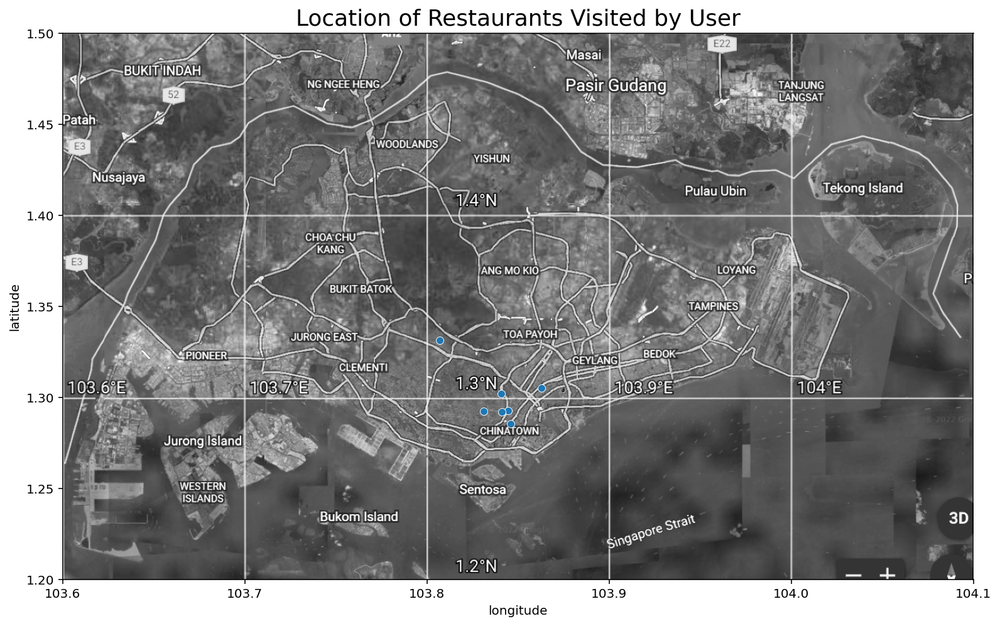

In [95]:
# Print user profile
get_user_profile(users[0])

**(a) User is at 79 Anson Road, S079906**

In [96]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[0], '079906')

User's location: 79 ANSON ROAD SINGAPORE 079906 (103.85, 1.27)
User is in restaurant cluster: 2
Total number of restaurants in recommended set: 138


,href,rest_name,pred_rating,longitude,latitude,dist_away
0,http://www.yelp.com/biz/man-man-japanese-unagi...,Man Man Japanese Unagi,4.98,103.841422,1.278918,1.37
2,http://www.yelp.com/biz/rhubarb-le-restaurant-...,Rhubarb Le Restaurant,4.89,103.842983,1.279428,1.30
3,http://www.yelp.com/biz/ah-tai-hainanese-chick...,Ah Tai Hainanese Chicken Rice,4.84,103.844747,1.280331,1.28
14,http://www.yelp.com/biz/terra-tokyo-italian-si...,Terra Tokyo Italian,4.61,103.844175,1.278020,1.10
16,http://www.yelp.com/biz/sanji-kagoshima-ramen-...,Sanji Kagoshima Ramen,4.57,103.843847,1.276937,1.03
23,http://www.yelp.com/biz/tandoori-culture-singa...,Tandoori Culture,4.55,103.847806,1.281775,1.32
35,http://www.yelp.com/biz/a-noodle-story-singapo...,A Noodle Story,4.49,103.846607,1.279218,1.09
41,http://www.yelp.com/biz/foong-kee-coffee-shop-...,Foong Kee Coffee Shop,4.48,103.841625,1.279455,1.40
50,http://www.yelp.com/biz/katanashi-an-singapore...,Katanashi An,4.43,103.847756,1.281806,1.33
53,http://www.yelp.com/biz/kok-sen-restaurant-sin...,Kok Sen Restaurant,4.41,103.841704,1.280243,1.46


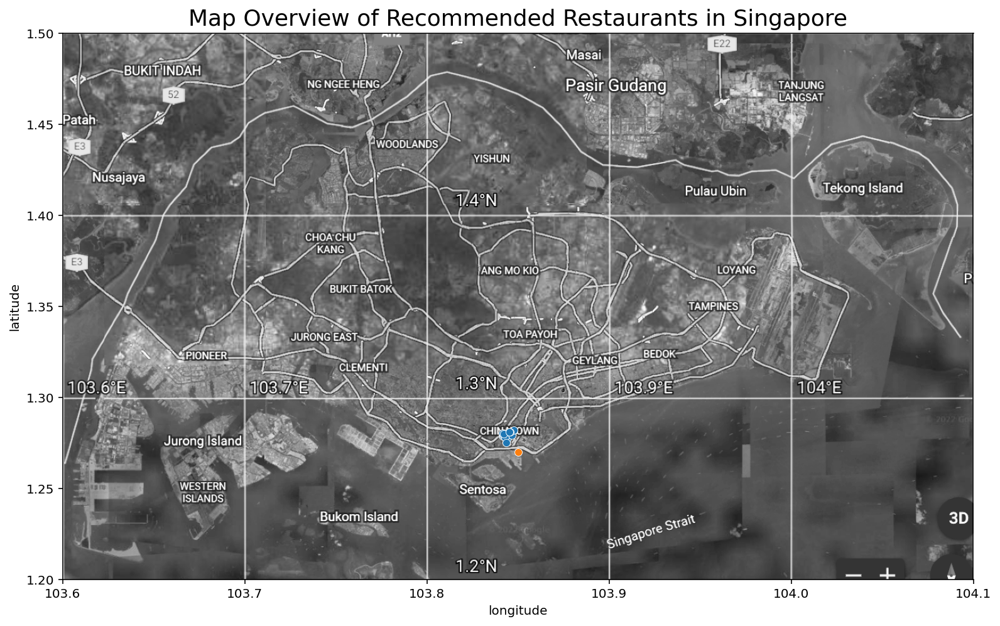

In [97]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

**(b) User is at Parkway Parade, 80 Marine Parade Rd, Singapore 449269**

In [98]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[0], '449269')

User's location: 80 MARINE PARADE ROAD HSBC MARINE PARADE BRANCH SINGAPORE 449269 (103.91, 1.3)
User is in restaurant cluster: 1
Total number of restaurants in recommended set: 141


,href,rest_name,pred_rating,longitude,latitude,dist_away
9,http://www.yelp.com/biz/delicious-boneless-chi...,Delicious Boneless Chicken Rice,4.70,103.901516,1.304097,1.05
16,http://www.yelp.com/biz/beach-road-prawn-noodl...,Beach Road Prawn Noodle House,4.56,103.911045,1.308505,0.95
29,http://www.yelp.com/biz/boon-tong-kee-singapor...,Boon Tong Kee,4.51,103.906577,1.307273,0.89
32,http://www.yelp.com/biz/the-original-katong-la...,The Original Katong Laksa,4.50,103.904686,1.303357,0.70
39,http://www.yelp.com/biz/mr-and-mrs-mohgans-sup...,Mr and Mrs Mohgan’s Super Crispy Roti Prata,4.48,103.901993,1.309692,1.39
46,http://www.yelp.com/biz/roland-singapore?osq=R...,Roland,4.46,103.906459,1.301290,0.42
49,http://www.yelp.com/biz/geylang-lorong-29-hokk...,Geylang Lorong 29 Hokkien Mee,4.44,103.911812,1.308671,0.98
57,http://www.yelp.com/biz/five-star-hainanese-ch...,Five Star Hainanese Chicken Rice,4.40,103.906378,1.307171,0.89
102,http://www.yelp.com/biz/sin-heng-claypot-bak-k...,Sin Heng Claypot Bak Koot Teh,4.21,103.904390,1.307176,1.01
131,http://www.yelp.com/biz/328-katong-laksa-singa...,328 Katong Laksa,3.97,103.903211,1.305096,0.94


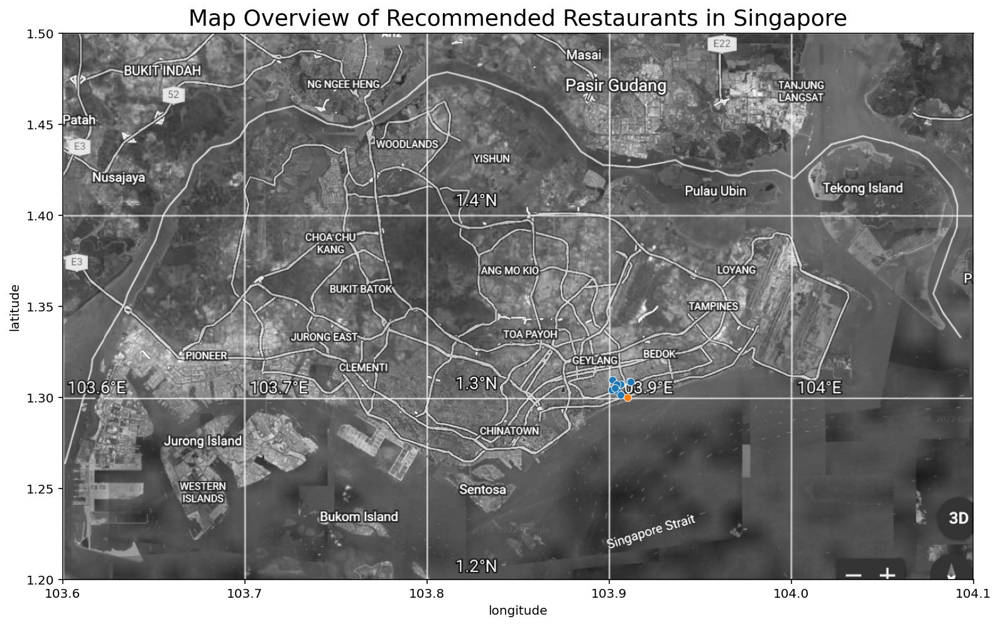

In [99]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

### User: Luciana Y. (ID: 52R6YBCMU0yycOHKcnTXhA)

**User Profile**

Username: Luciana Y.
User Id: 52R6YBCMU0yycOHKcnTXhA
User from: Singapore, Singapore
Number of restaurants visited: 8

Top 5 restaurant categories:
french
breakfast_&_brunch
pizza
japanese
coffee_&_tea

Top 5 restaurants based on user rating:

                      rest_name  user_rating
2          Group Therapy Coffee            4
3                   L’Entrecôte            4
4  Kitchenette by Saigon Allley            4
6             The Clifford Pier            4
0                      Imakatsu            3


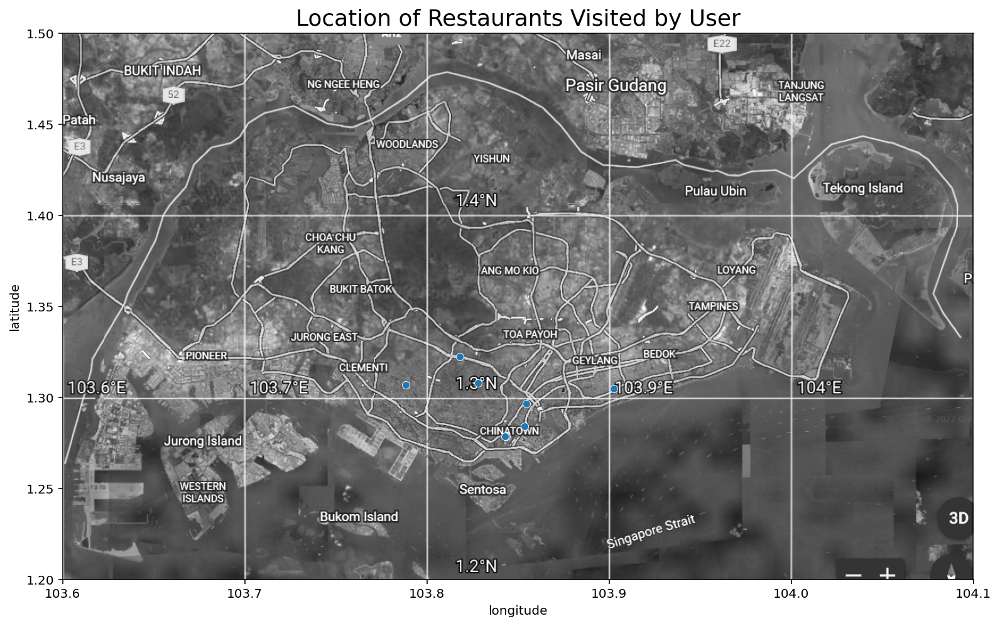

In [100]:
# Print user profile
get_user_profile(users[1])

**(a) User is at 79 Anson Road, S079906**

In [101]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[1], '079906')

User's location: 79 ANSON ROAD SINGAPORE 079906 (103.85, 1.27)
User is in restaurant cluster: 2
Total number of restaurants in recommended set: 186


,href,rest_name,pred_rating,longitude,latitude,dist_away
0,http://www.yelp.com/biz/man-man-japanese-unagi...,Man Man Japanese Unagi,4.45,103.841422,1.278918,1.37
1,http://www.yelp.com/biz/rhubarb-le-restaurant-...,Rhubarb Le Restaurant,4.40,103.842983,1.279428,1.30
3,http://www.yelp.com/biz/two-men-bagel-house-si...,Two Men Bagel House,4.33,103.844320,1.274710,0.82
9,http://www.yelp.com/biz/trattoria-nonna-lina-s...,Trattoria Nonna Lina,4.15,103.840491,1.278514,1.42
11,http://www.yelp.com/biz/terra-tokyo-italian-si...,Terra Tokyo Italian,4.11,103.844175,1.278020,1.10
12,http://www.yelp.com/biz/ramen-keisuke-tori-kin...,Ramen Keisuke Tori King,4.11,103.843471,1.274588,0.89
14,http://www.yelp.com/biz/tandoori-culture-singa...,Tandoori Culture,4.09,103.847806,1.281775,1.32
16,http://www.yelp.com/biz/sanji-kagoshima-ramen-...,Sanji Kagoshima Ramen,4.07,103.843847,1.276937,1.03
25,http://www.yelp.com/biz/employees-only-singapo...,Employees Only,4.02,103.847526,1.282128,1.37
31,http://www.yelp.com/biz/etna-italian-restauran...,Etna Italian Restaurant,3.99,103.843378,1.278299,1.18


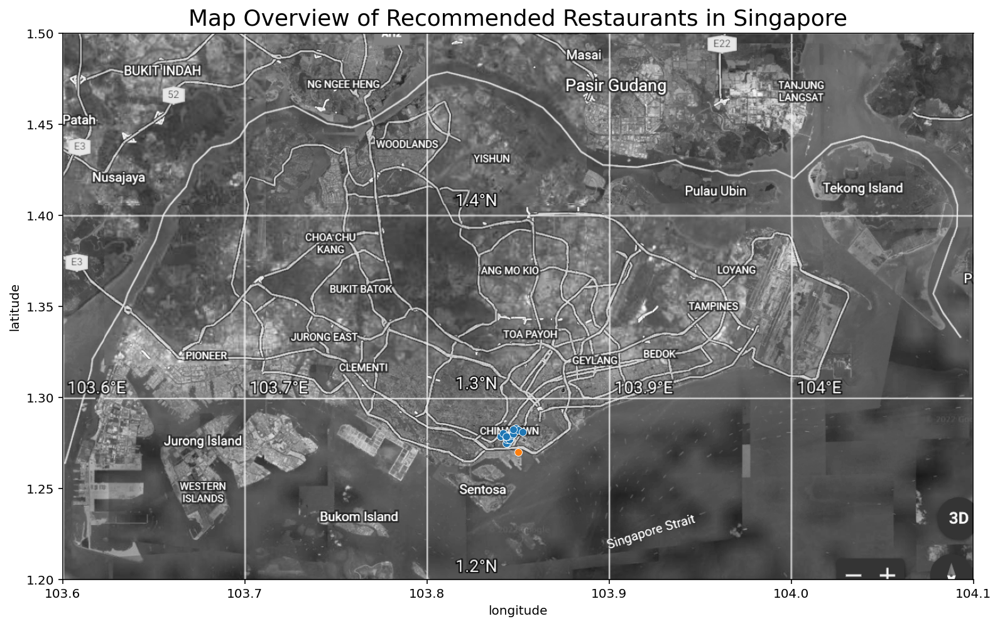

In [102]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

**(b) User is at Nex Shopping Centre, 23 Serangoon Central, Singapore 556083**

In [103]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[1], '556083')

User's location: 23 SERANGOON CENTRAL CITIBANK NEX MALL SINGAPORE 556083 (103.87, 1.35)
User is in restaurant cluster: 0
Total number of restaurants in recommended set: 186


,href,rest_name,pred_rating,longitude,latitude,dist_away
10,http://www.yelp.com/biz/cottontail-creamery-si...,Cottontail Creamery,4.05,103.868997,1.350352,0.12
32,http://www.yelp.com/biz/fragrant-garden-singap...,Fragrant Garden,3.93,103.878828,1.353481,1.06
48,http://www.yelp.com/biz/mustard-seed-singapore...,Mustard Seed,3.86,103.871270,1.362946,1.44
79,http://www.yelp.com/biz/hong-chang-eating-hous...,Hong Chang Eating House,3.76,103.870403,1.343503,0.72
122,http://www.yelp.com/biz/la-pizzaiola-singapore...,La Pizzaiola,3.67,103.867436,1.347476,0.40


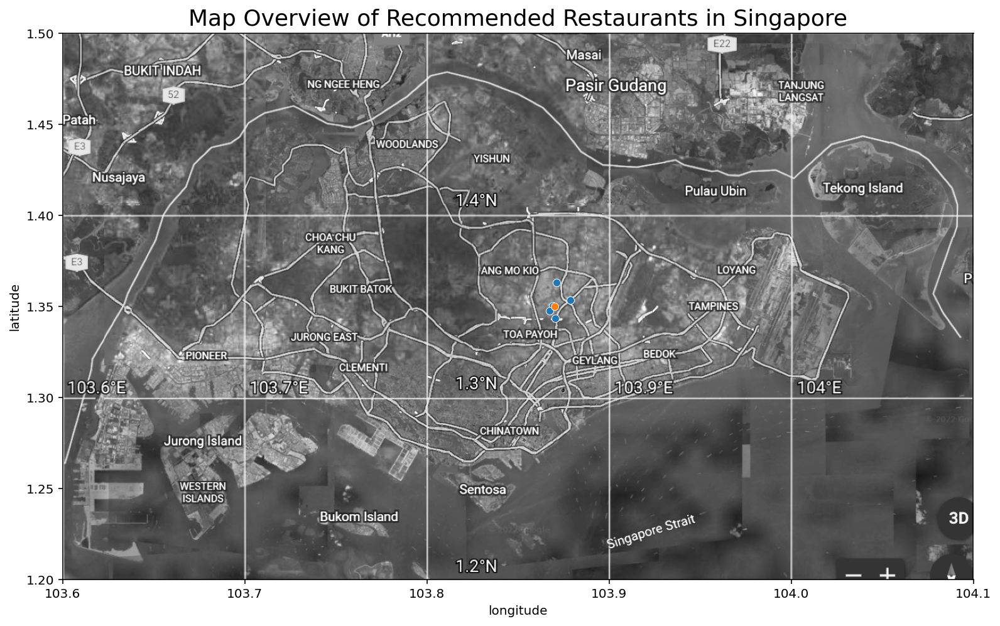

In [104]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

### User: Clarissa L. (ID: RACaZuc0YD9jRPAtaust5g)

**User Profile**

Username: Clarissa L.
User Id: RACaZuc0YD9jRPAtaust5g
User from: Basel, Switzerland
Number of restaurants visited: 35

Top 5 restaurant categories:
chinese
italian
thai
coffee_&_tea
filipino

Top 5 restaurants based on user rating:

                  rest_name  user_rating
17            The Sushi Bar            5
33                Tapa King            5
31       Tonkatsu Ma Maison            5
8                      Alif            5
18  Ryoshi Sushi IkeIkeMaru            5


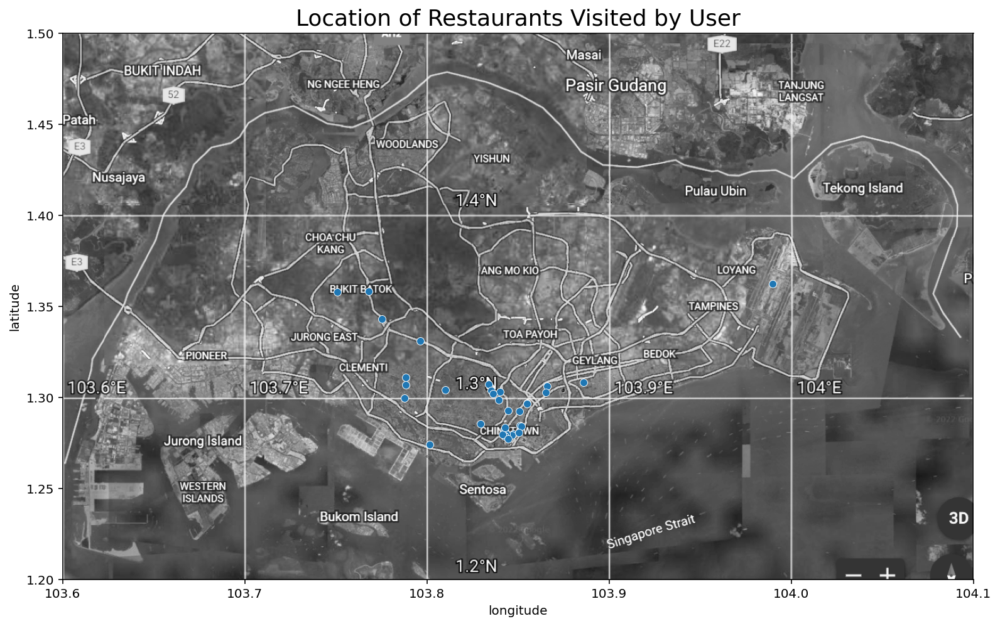

In [105]:
# Print user profile
get_user_profile(users[2])

**(a) User is at 79 Anson Road, S079906**

In [106]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[2], '079906')

User's location: 79 ANSON ROAD SINGAPORE 079906 (103.85, 1.27)
User is in restaurant cluster: 2
Total number of restaurants in recommended set: 332


,href,rest_name,pred_rating,longitude,latitude,dist_away
1,http://www.yelp.com/biz/man-man-japanese-unagi...,Man Man Japanese Unagi,4.55,103.841422,1.278918,1.37
2,http://www.yelp.com/biz/two-men-bagel-house-si...,Two Men Bagel House,4.55,103.844320,1.274710,0.82
3,http://www.yelp.com/biz/rhubarb-le-restaurant-...,Rhubarb Le Restaurant,4.52,103.842983,1.279428,1.30
12,http://www.yelp.com/biz/ah-tai-hainanese-chick...,Ah Tai Hainanese Chicken Rice,4.34,103.844747,1.280331,1.28
15,http://www.yelp.com/biz/terra-tokyo-italian-si...,Terra Tokyo Italian,4.25,103.844175,1.278020,1.10
16,http://www.yelp.com/biz/ramen-keisuke-tori-kin...,Ramen Keisuke Tori King,4.25,103.843471,1.274588,0.89
26,http://www.yelp.com/biz/trattoria-nonna-lina-s...,Trattoria Nonna Lina,4.18,103.840491,1.278514,1.42
30,http://www.yelp.com/biz/sanji-kagoshima-ramen-...,Sanji Kagoshima Ramen,4.16,103.843847,1.276937,1.03
32,http://www.yelp.com/biz/etna-italian-restauran...,Etna Italian Restaurant,4.16,103.843378,1.278299,1.18
34,http://www.yelp.com/biz/tandoori-culture-singa...,Tandoori Culture,4.15,103.847806,1.281775,1.32


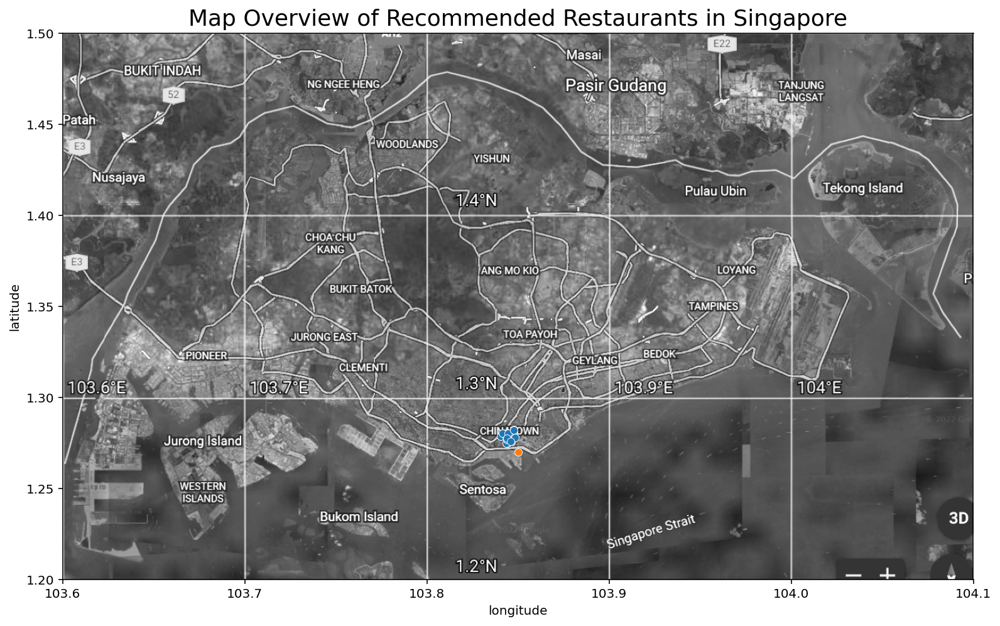

In [107]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

**(b) User is at JEM, 50 Jurong Gateway Rd, Singapore 608549**

In [108]:
# Get restaurant recommendations based on location. 
rec_rest, loc = get_recommendations(users[2], '608549')

User's location: 50 JURONG GATEWAY ROAD JEM SINGAPORE 608549 (103.74, 1.33)
User is in restaurant cluster: 3
Total number of restaurants in recommended set: 328


,href,rest_name,pred_rating,longitude,latitude,dist_away
26,http://www.yelp.com/biz/tsukada-nojo-singapore...,Tsukada Nojo,4.15,103.742586,1.334025,0.53
37,http://www.yelp.com/biz/din-tai-fung-singapore...,Din Tai Fung,4.12,103.742286,1.333153,0.43
45,http://www.yelp.com/biz/hai-di-lao-singapore-2...,Hai Di Lao,4.08,103.746895,1.334875,0.94
92,http://www.yelp.com/biz/ippudo-westgate-singap...,Ippudo Westgate,3.98,103.742586,1.334025,0.53
105,http://www.yelp.com/biz/toriki-yakitori-and-cr...,Toriki. Yakitori And Craft Beer,3.95,103.740187,1.333323,0.37
117,http://www.yelp.com/biz/swensens-singapore-12?...,Swensen’s,3.93,103.746895,1.334875,0.94
139,http://www.yelp.com/biz/en-sakaba-singapore-2?...,En Sakaba,3.90,103.743279,1.333293,0.52
196,http://www.yelp.com/biz/greendot-singapore?osq...,Greendot,3.81,103.742586,1.334025,0.53
236,http://www.yelp.com/biz/coco-ichibanya-singapo...,Coco Ichibanya,3.73,103.742586,1.334025,0.53
244,http://www.yelp.com/biz/zaffron-kitchen-westga...,Zaffron Kitchen Westgate,3.71,103.742286,1.333153,0.43


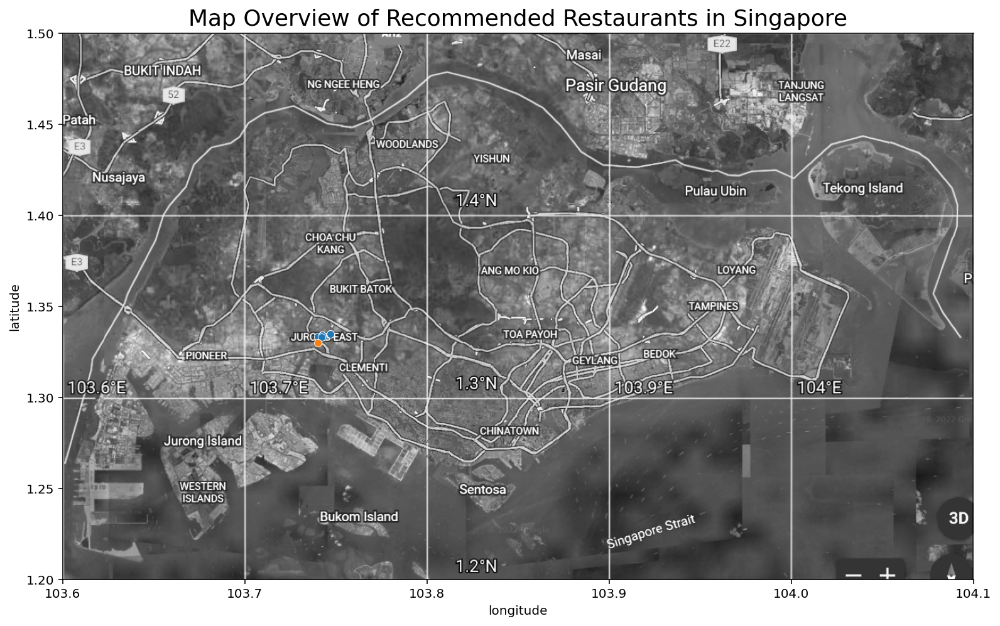

In [109]:
dist = 1.5
top_n = 20

plot_rest_map(rec_rest[rec_rest['dist_away']<dist].head(top_n), loc)
rec_rest[rec_rest['dist_away']<dist].head(top_n)

## 10. Conclusion and Recommendations
1. The project successfully developed a SG Food Recommender using restaurants information and users' reviews scrapped from Yelp website. 

2. From the Exploratory Data Analysis, 
    - There are almost five times more overseas users who reviewed the restaurants than locals. However, the number of reviews by overseas users and locals are comparable. 
    - From the most common bigrams and trigrams used in the `comment` column, many findings are related to food unique to Singapore, such as chicken rice, chilli crab and bak kut teh. 
    - Hence, it is recommended that the SG Food recommender be marketed to overseas travellers who wants to explore unqiuely Singapore food and restaurants, which are largely largely reviewed by locals.
<br><br>
3. From the recommender system, the recommender filter restaurants based on user location, restaurants highly rated by similar users and restaurants similar to those highly rated by the user. The 'svd' model is used to predict the rating of restaurants not visited by the user. The top rated restaurants predicted by the model is then recommended to the user. 
    - Three case studies were conducted and concluded that the SG Food Recommender was able to predict ratings of restaurants not visited by the users. 
    - The recommender provided relevant recommended restaurants based on distance and user location. 


## 11. Future Works
1. **Building database**. Other than Yelp website, other reviews from other website and social media could be referenced to gather a more comprehensive data set for training, testing and deploying. 
2. **Implicit Data**. The project could explore collecting users' activity, such as clicking on restaurant link etc, on Yelp to be used to enhance the cosine similarity between users. 
3. **Content of Users' Comment**. While EDA identified top bi-grams and tri-grams, they are not used in the development of the recommender system. In addition, users' sentiments were also not considered. These could be included in future enhancement of the recommender to better personalised the recommendations. 
4. **Neural Network and Deep Learning**. These could be explored for future enhancement of the recommender system. 

# <center> END OF NOTEBOOK </center>